## Deep Learning for HiRISE Crater Detection


In [1]:
import os
import torch
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import cv2
from scipy.misc import imsave, imresize
import matplotlib as mpl

import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torch.autograd import Variable

from scipy.misc import imread, imsave
from osgeo import gdal, osr, ogr

In [2]:
CTX_PATH = "/home-nfs/ivas/ivas/data/CTX/ctx_dataset/cleaned_files.txt"
ctx_image_list = [x.strip() for x in open(CTX_PATH).readlines()]
tmp = '/home-nfs/ivas/ivas/data/CTX/CTX' + ctx_image_list[0][1:] 
gtif = gdal.Open(tmp)
band = gtif.GetRasterBand(1)
raster_data = band.ReadAsArray()

### Dataset

Say a few things about how the dataset was collected and created here.

1612
[[294.         437.          37.99301312]
 [288.         324.          28.46124932]]
(512, 512)


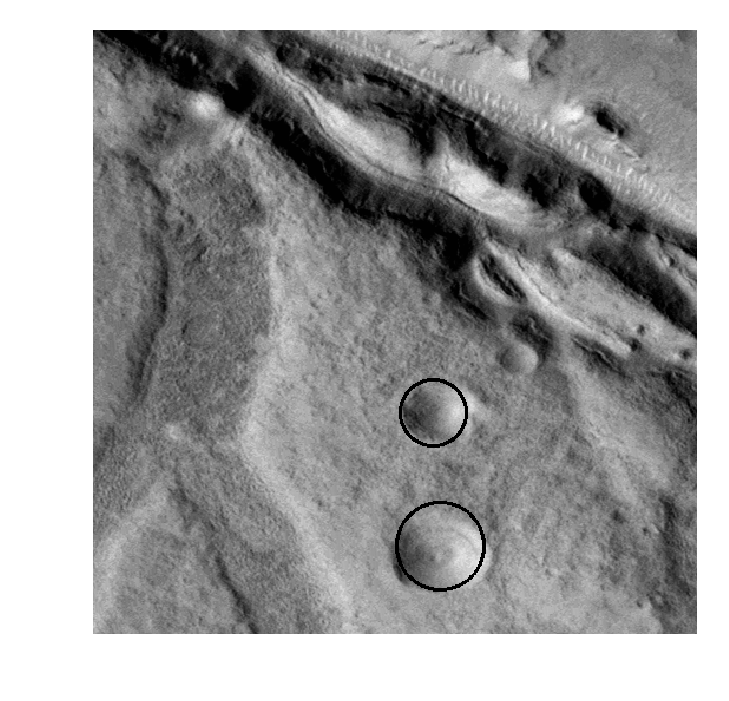

[280.          37.          35.61473644]
(512, 512)


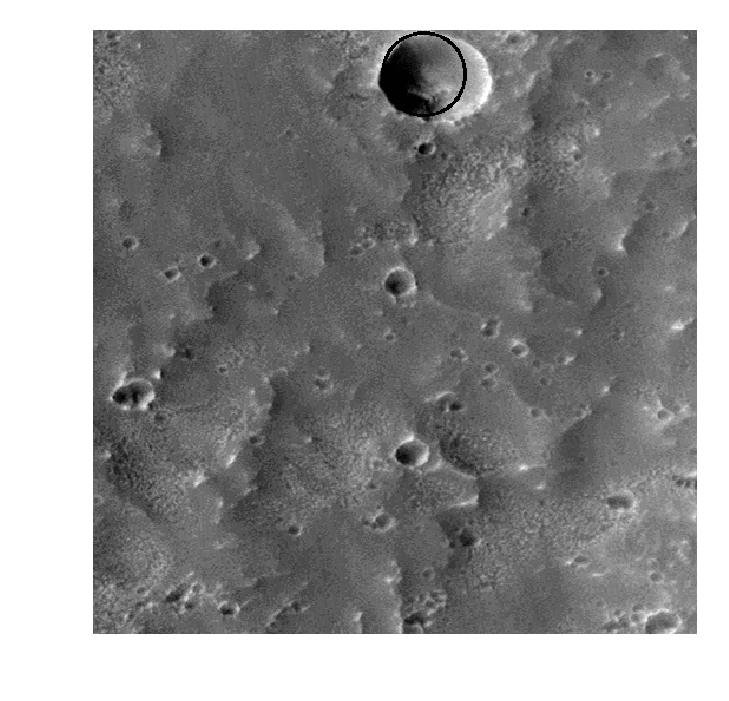

[[349.         465.          43.14076482]
 [ 55.         458.          39.60206705]]
(512, 512)


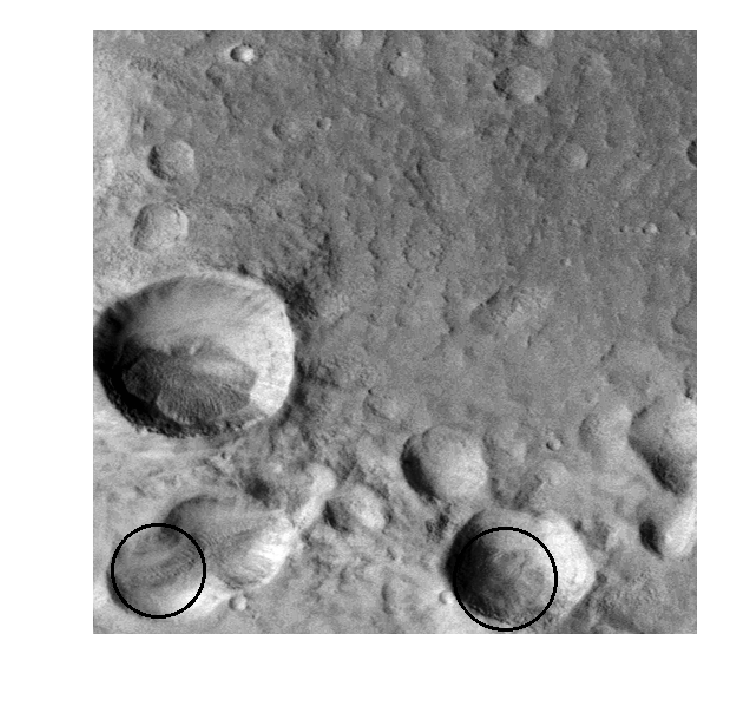

[[ 85.         296.          35.89995273]
 [334.         140.          23.17681037]]
(512, 512)


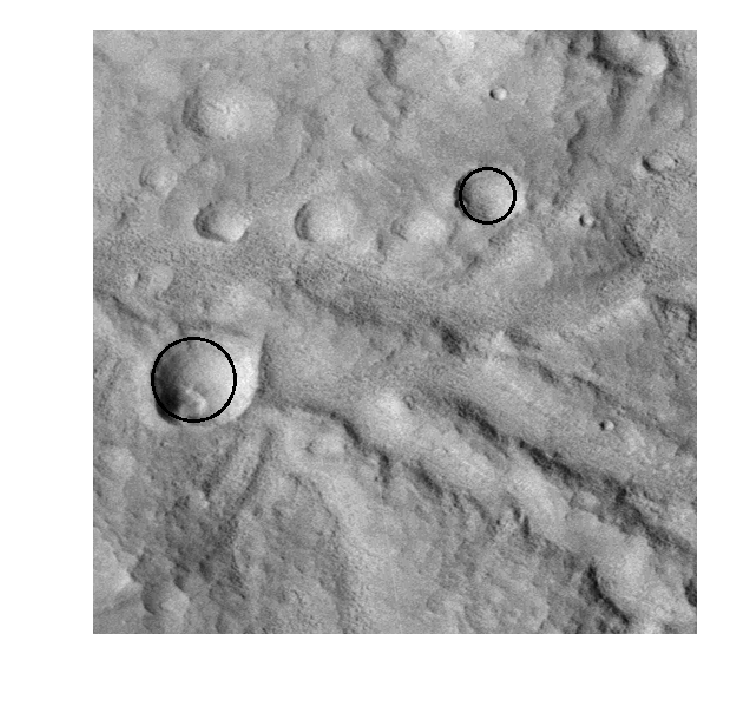

[404.       412.        61.460958]
(512, 512)


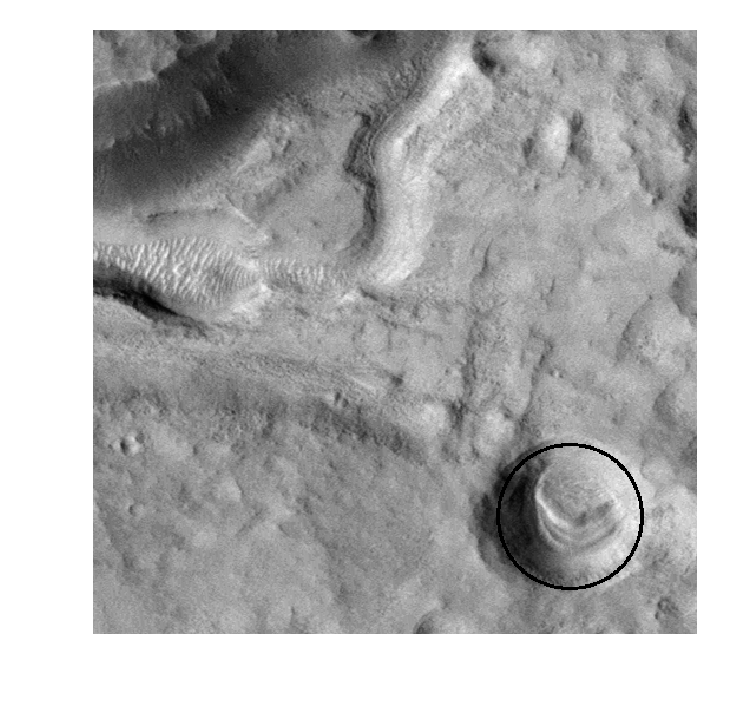

[[119.         378.          21.49438224]
 [395.         481.          32.94929257]]
(512, 512)


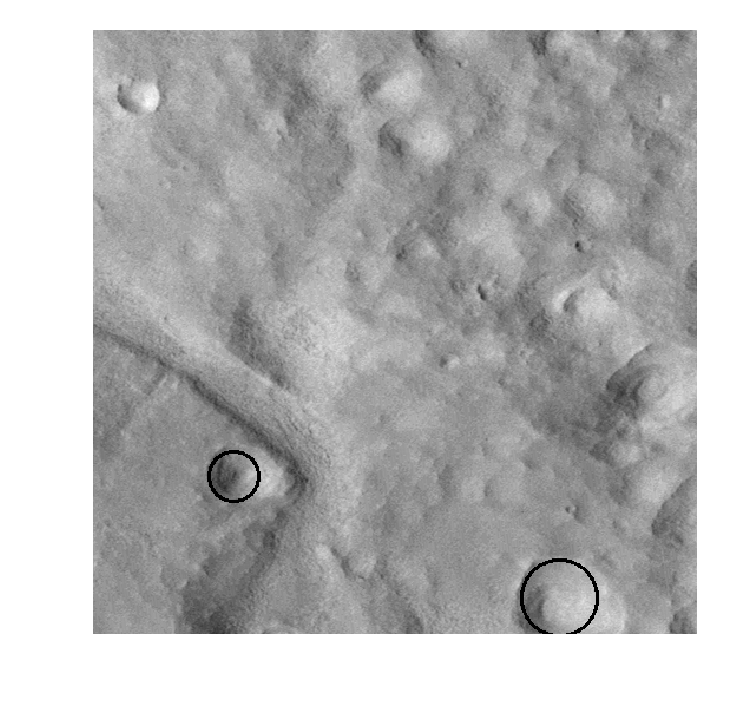

[[151.         352.          17.03814814]
 [336.         192.          13.66528827]
 [438.         127.          14.41740724]]
(512, 512)


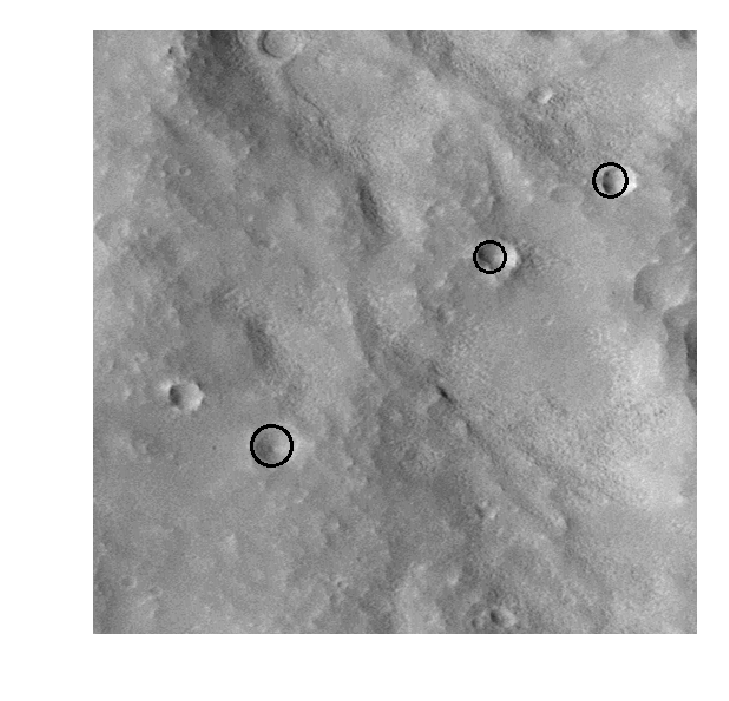

[247.         291.          39.89756748]
(512, 512)


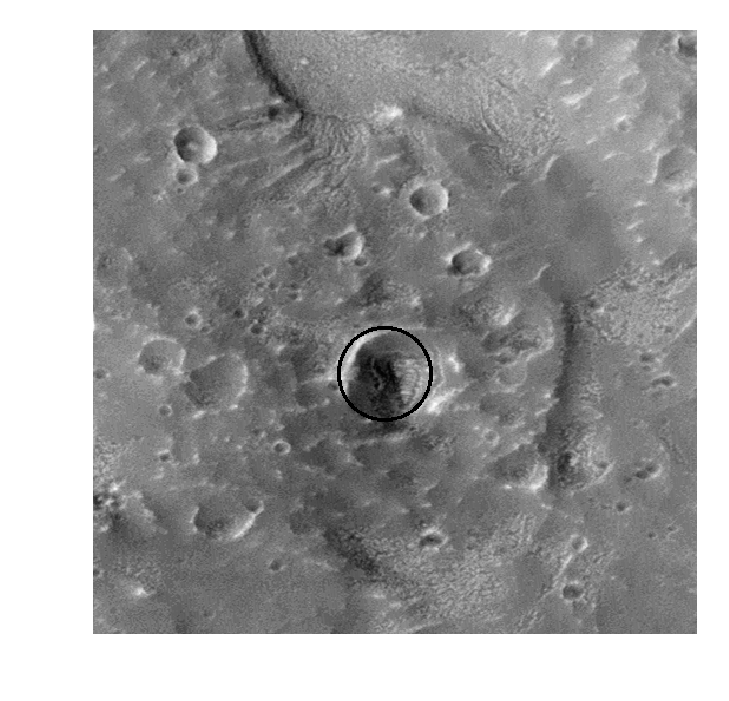

[238.         322.          28.78450896]
(512, 512)


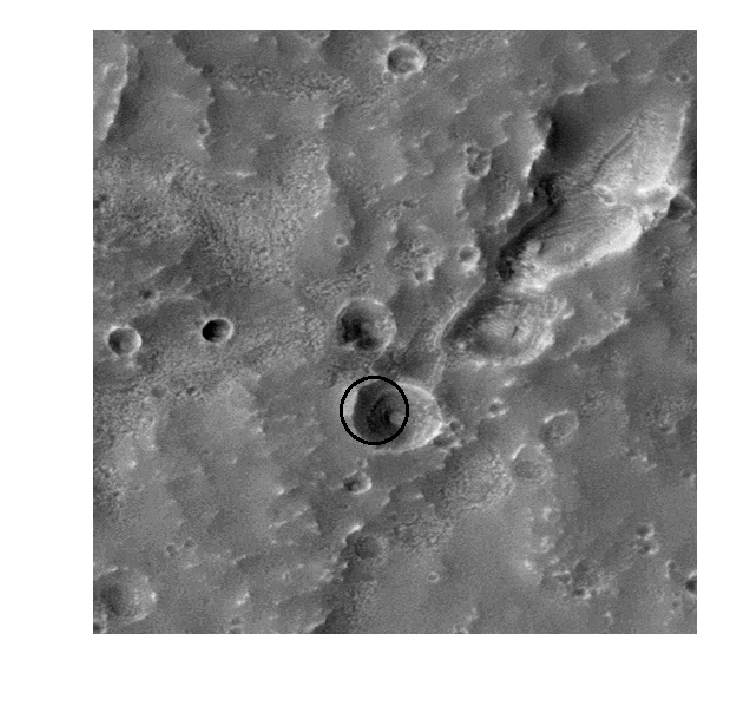

[432.         315.          36.27835643]
(512, 512)


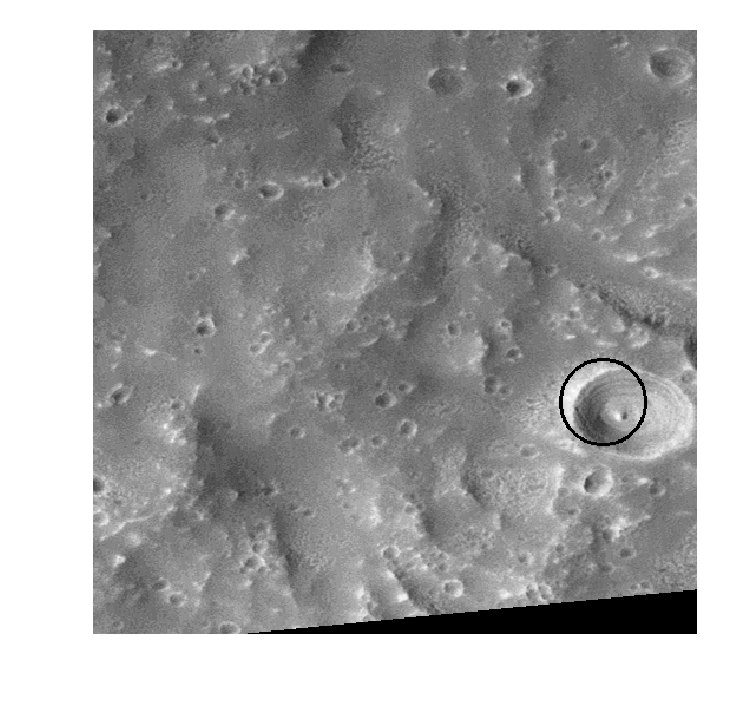

[155.          68.          29.71768965]
(512, 512)


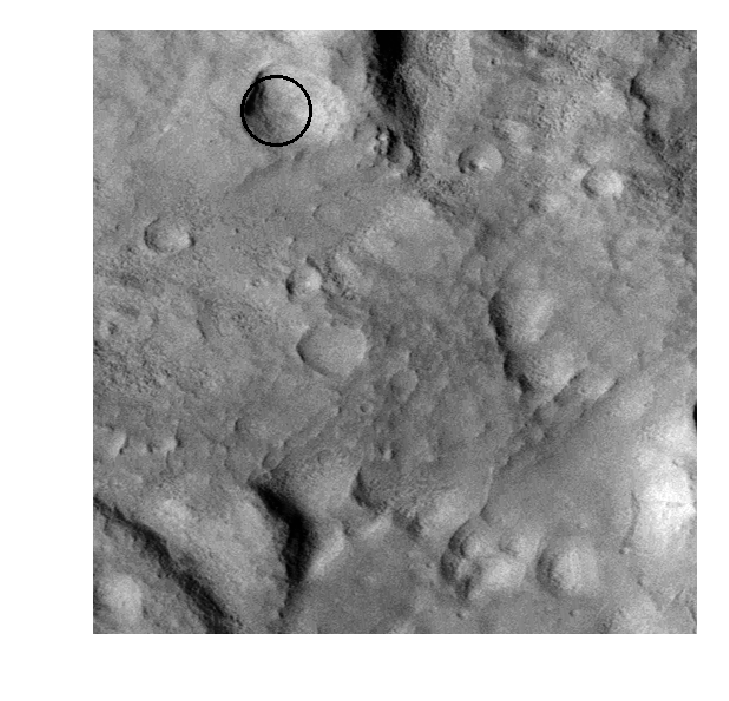

[[168.         265.          31.00828147]
 [359.         413.          20.87299002]
 [303.         267.          28.2250829 ]]
(512, 512)


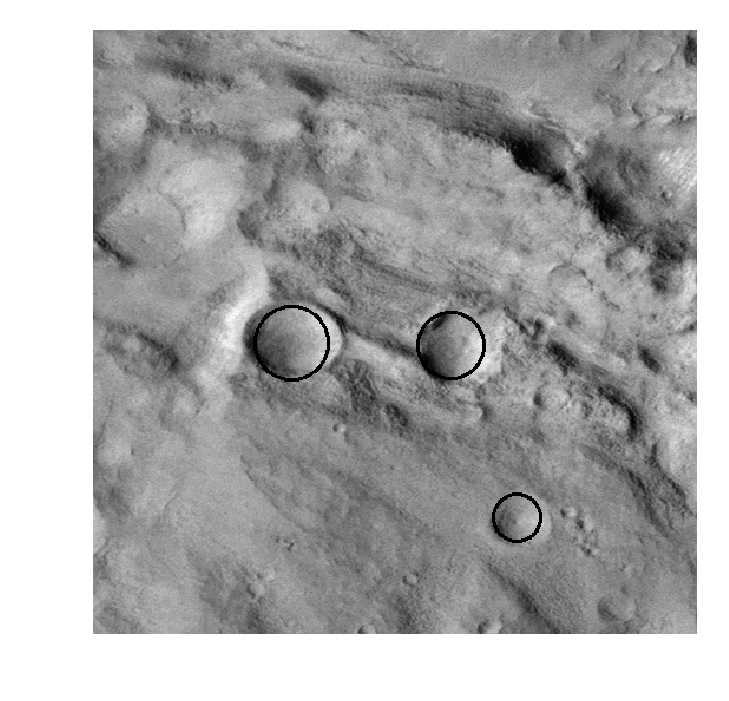

[186.        313.         16.0315529]
(512, 512)


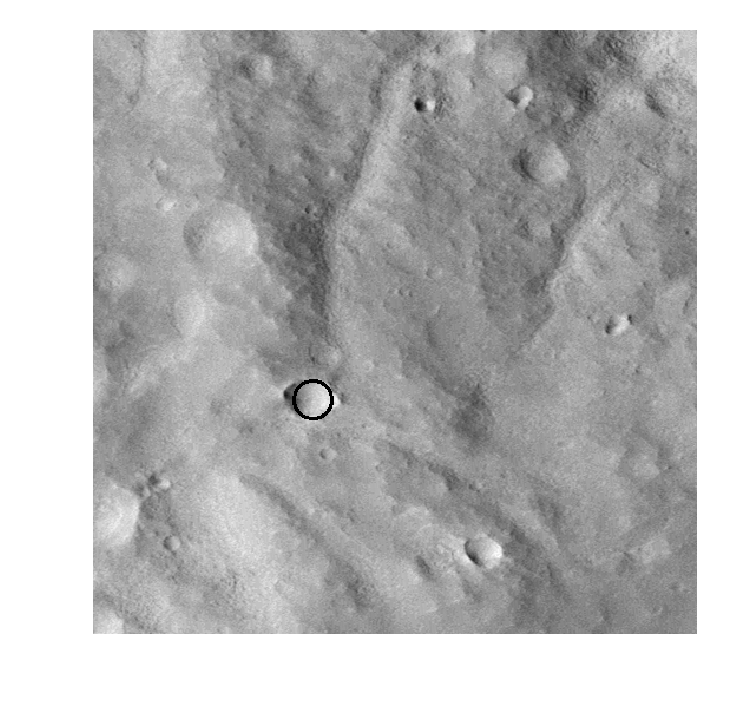

[[449.         482.          36.44084712]
 [426.         112.          22.22687488]
 [188.         455.          22.30982401]
 [264.         160.          45.82749968]]
(512, 512)


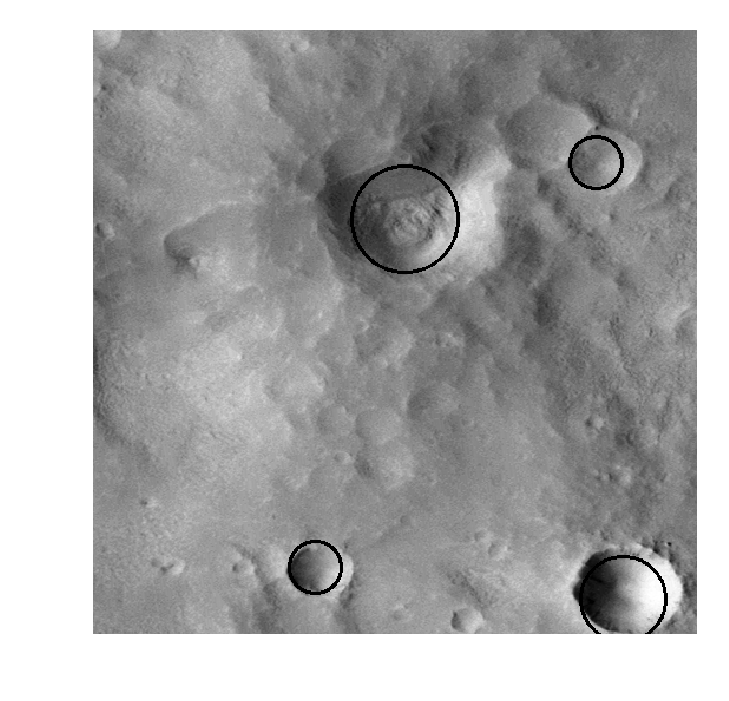

[304.          53.          21.99831524]
(512, 512)


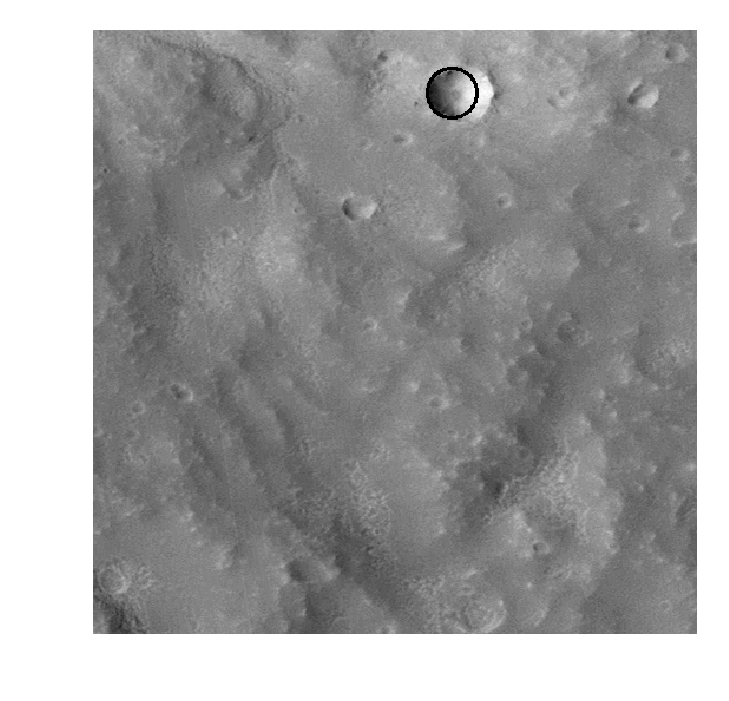

[315.        381.         71.2311112]
(512, 512)


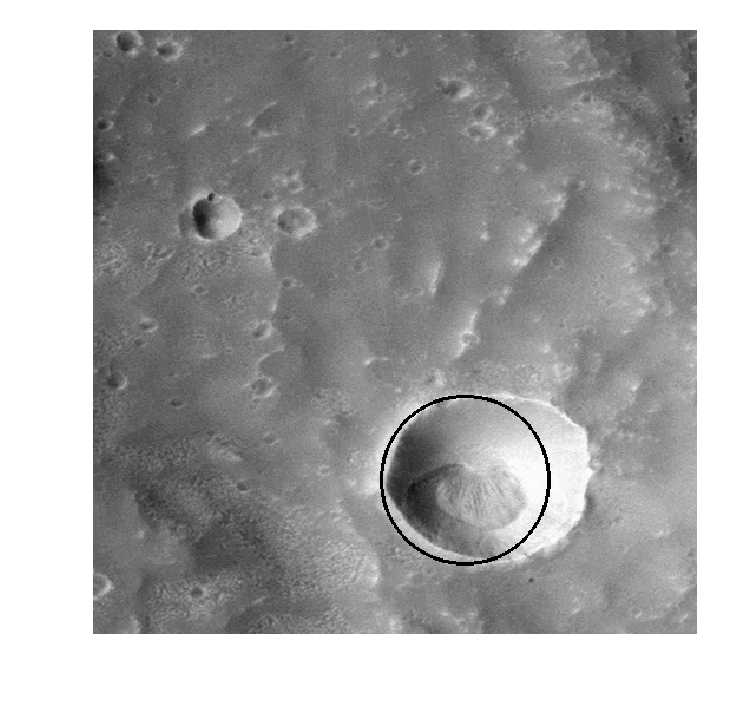

[[ 57.         327.          54.90348509]
 [ 75.         214.          17.92716057]]
(512, 512)


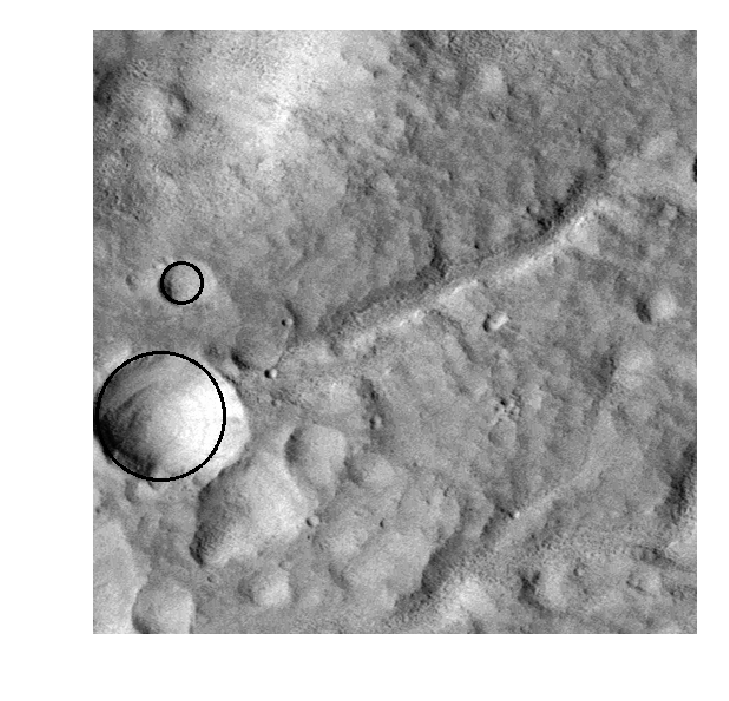

[[189.         145.          24.14242275]
 [277.         431.          16.77072616]]
(512, 512)


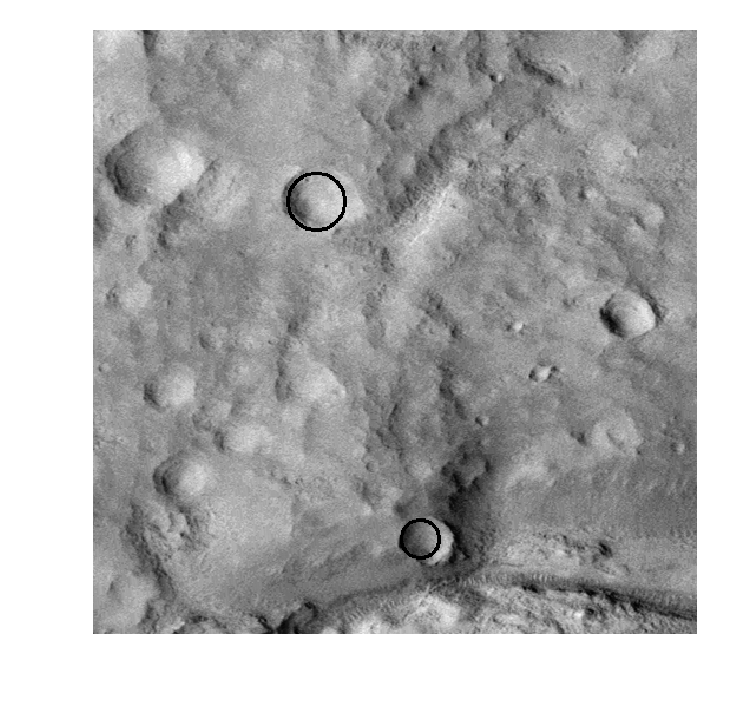

[[423.         421.          24.83696898]
 [133.          33.          28.69329034]]
(512, 512)


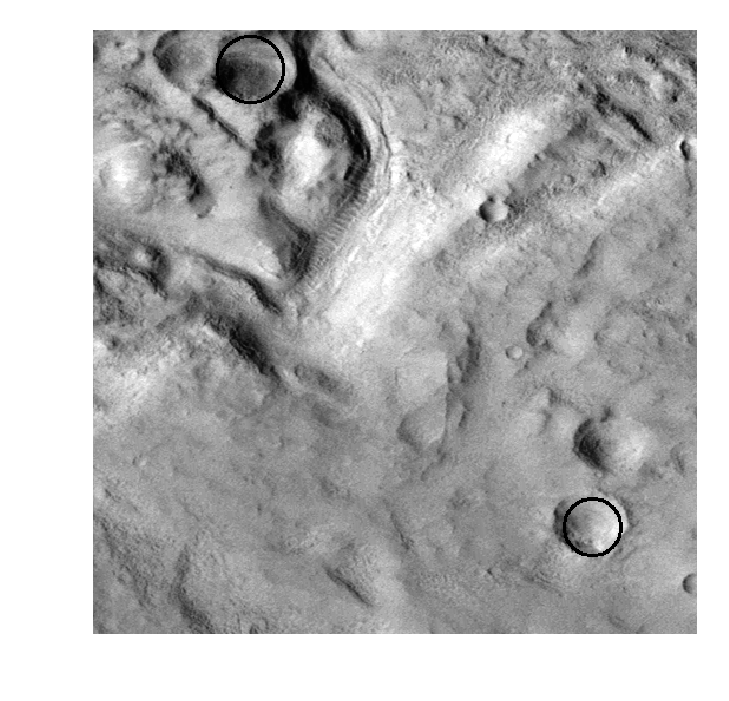

[[271.         313.          52.76753096]
 [459.         145.          21.06551315]]
(512, 512)


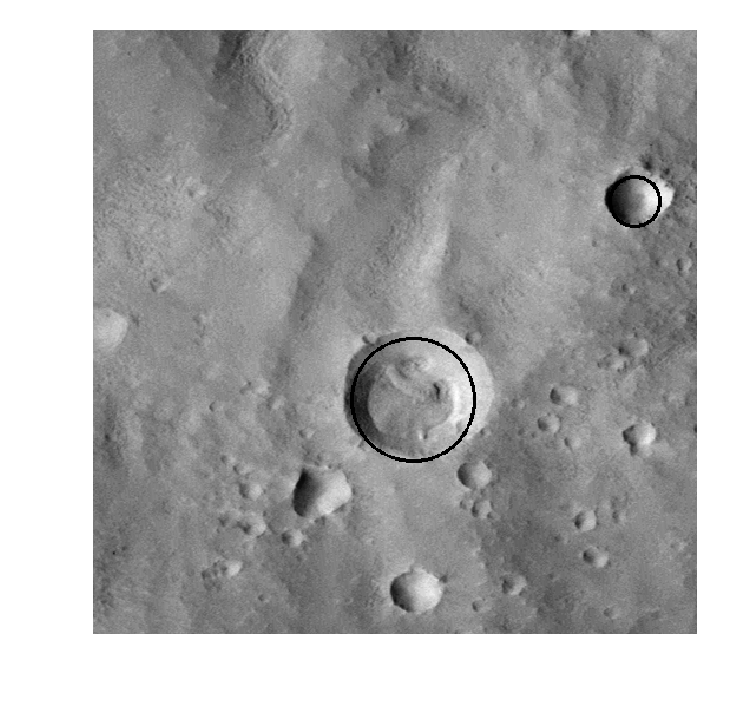

[107.         246.          64.33444805]
(512, 512)


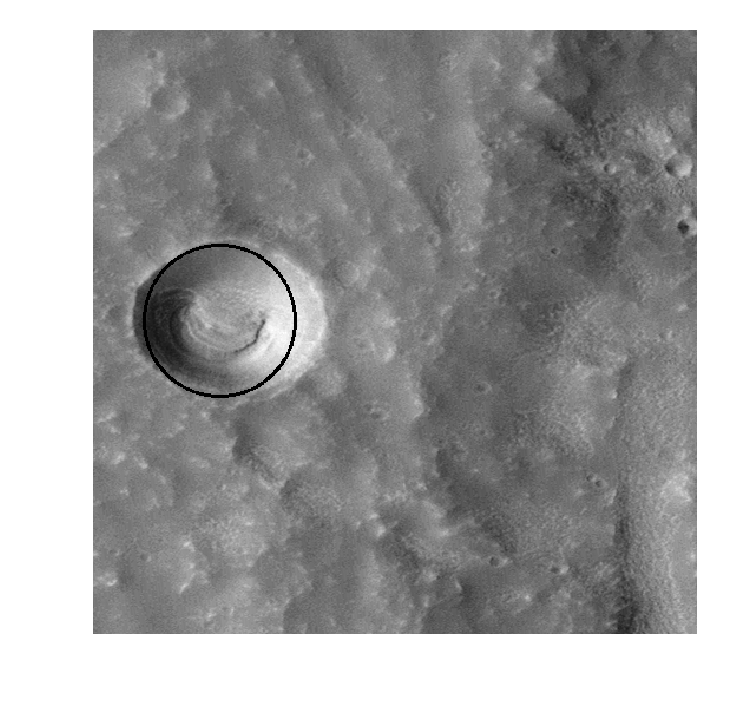

[[ 27.         115.          27.60992375]
 [148.         269.          19.26883529]
 [146.         371.          28.35545692]]
(512, 512)


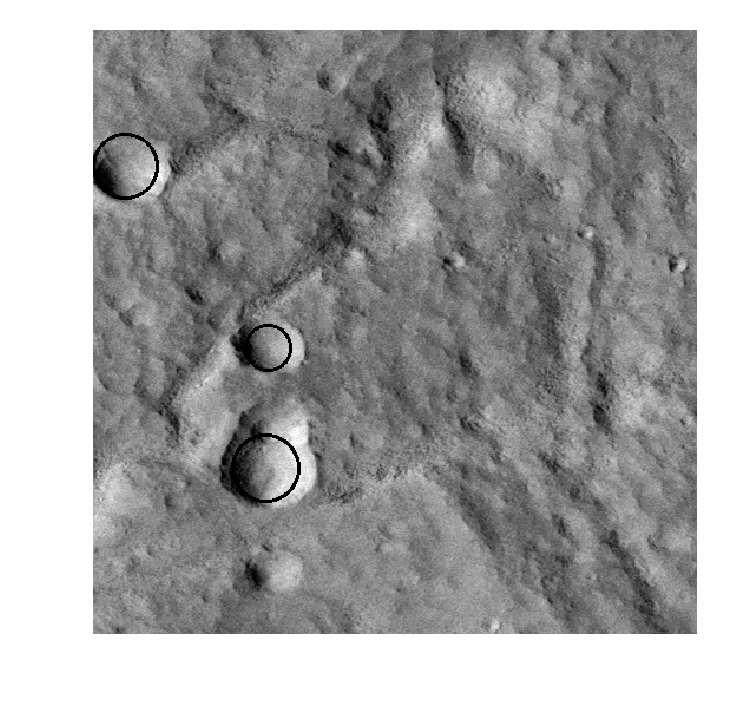

[258.         470.          22.10584062]
(512, 512)


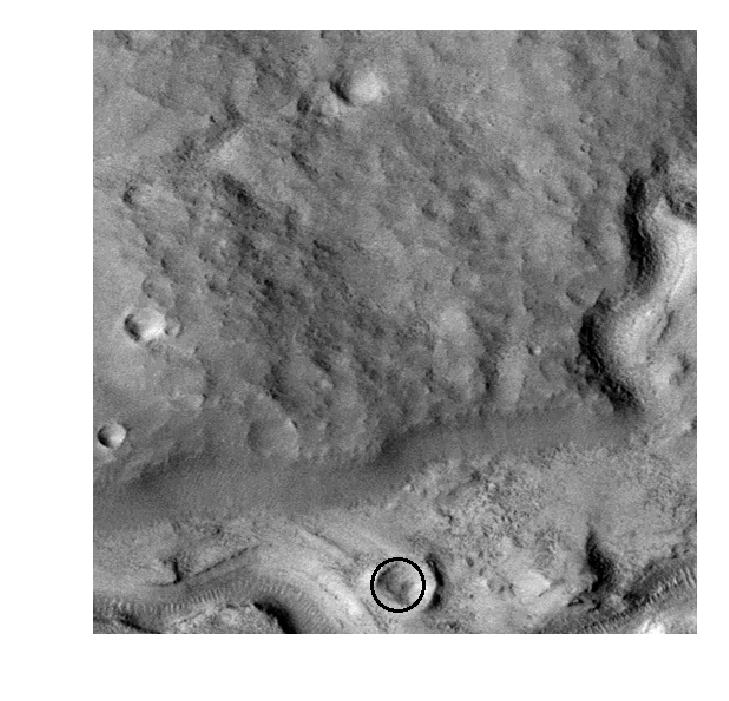

[322.         472.          15.39087361]
(512, 512)


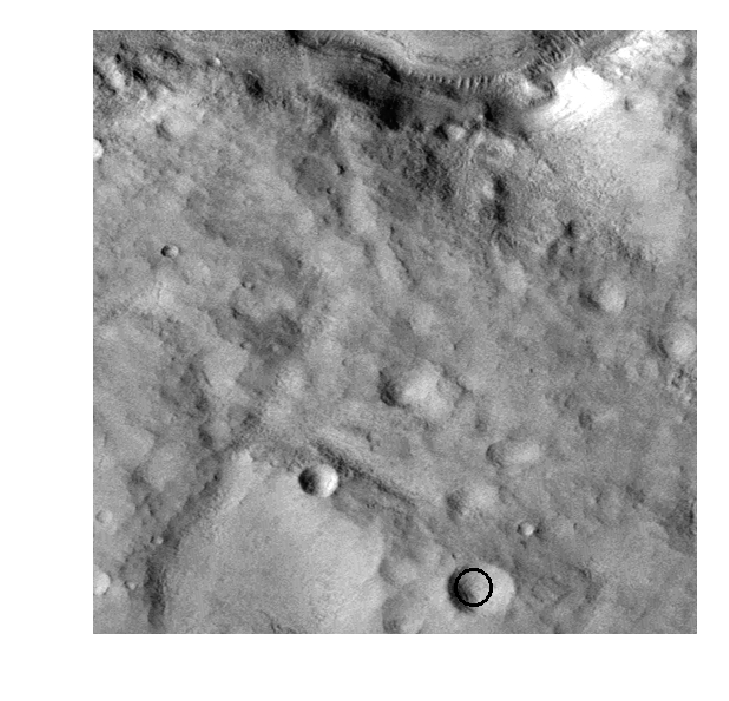

[368.         143.          23.08388432]
(512, 512)


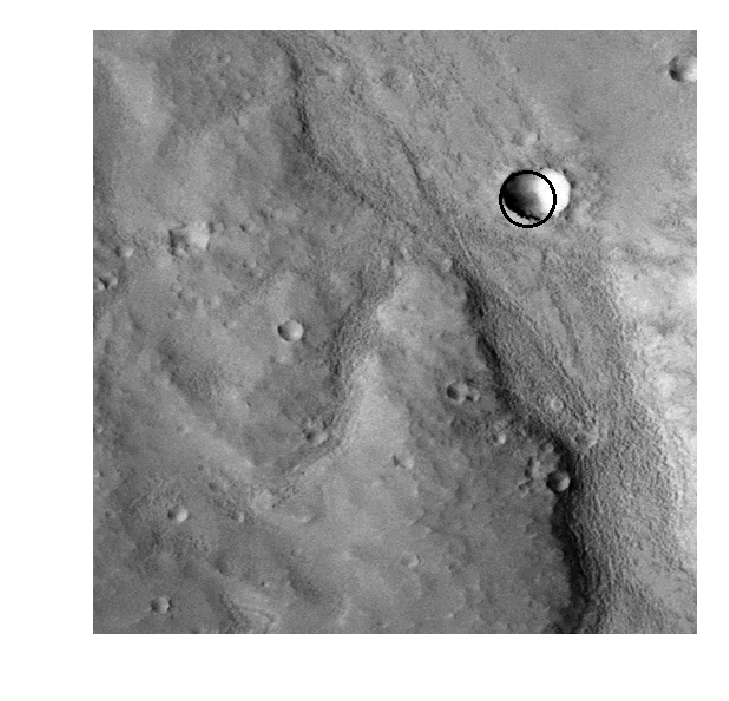

[340.          72.          25.30593898]
(512, 512)


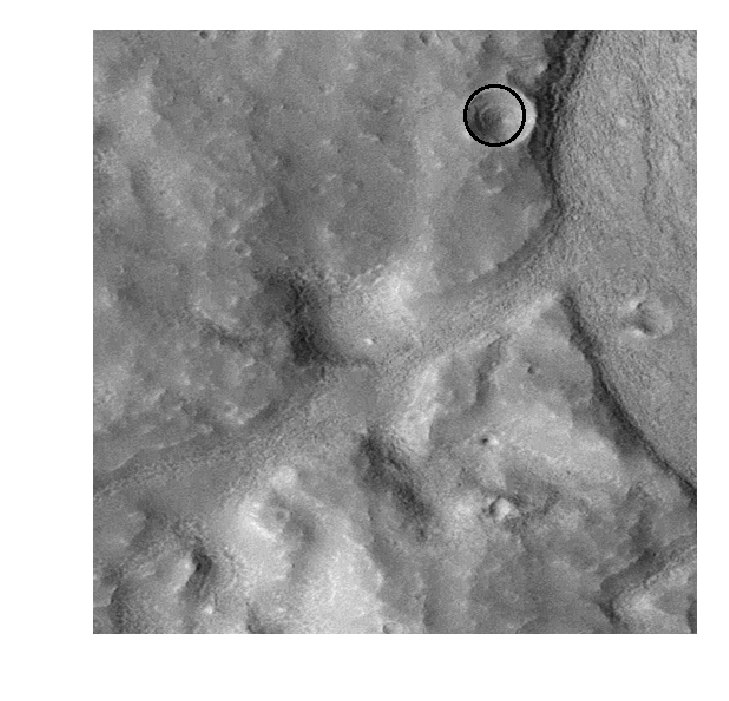

[ 63.         253.          65.77692345]
(512, 512)


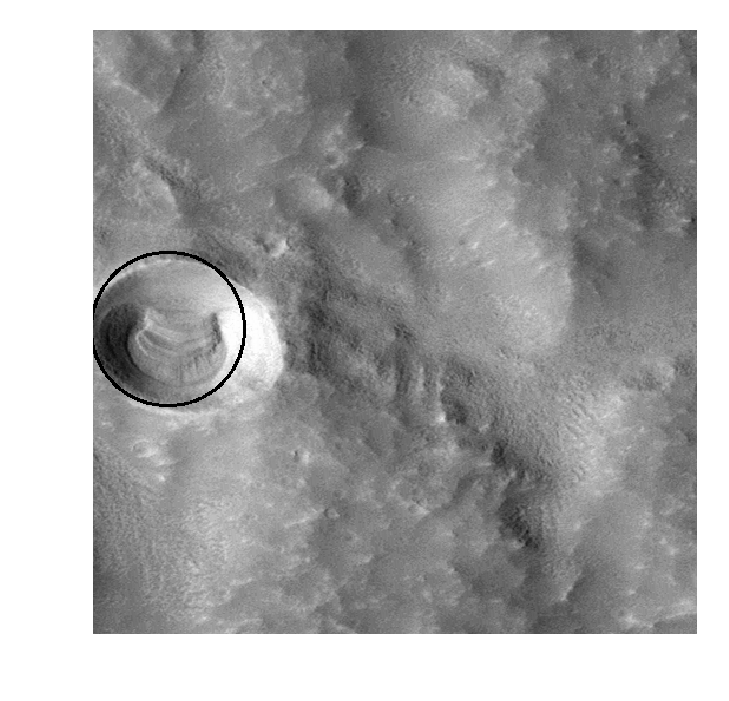

[[379.         404.          48.64044885]
 [164.         463.          20.96165912]
 [410.         202.          27.96526673]]
(512, 512)


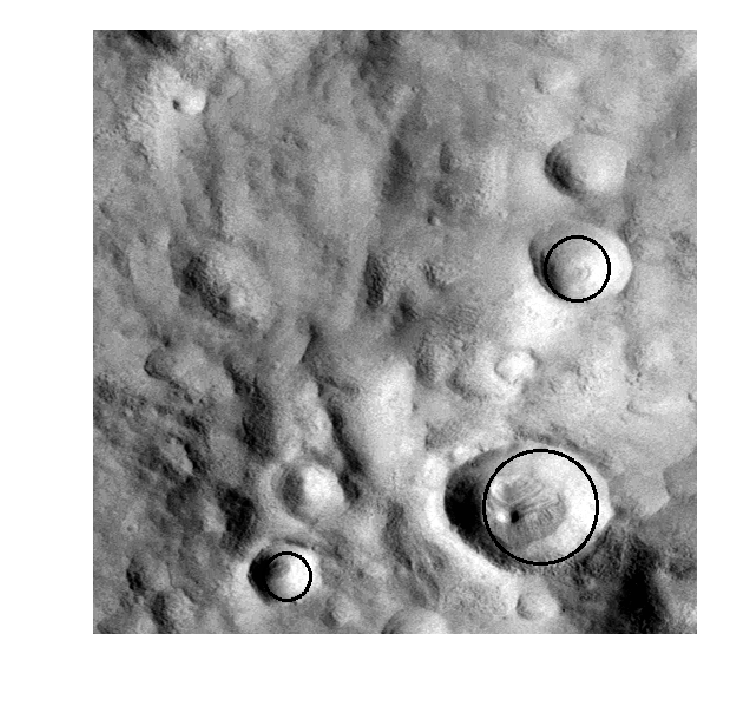

[[299.         457.          41.35787313]
 [200.         124.          25.1155297 ]
 [272.           3.          22.02317479]
 [441.         454.          38.22738461]
 [322.         366.          28.25875024]
 [177.         332.          22.4552283 ]]
(512, 512)


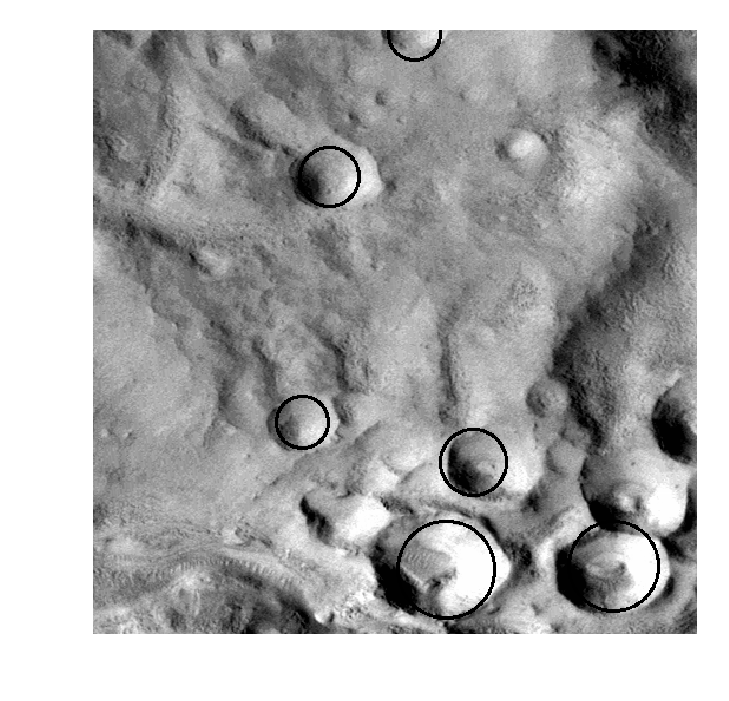

[[257.         409.          22.55331586]
 [319.         149.          28.49355188]]
(512, 512)


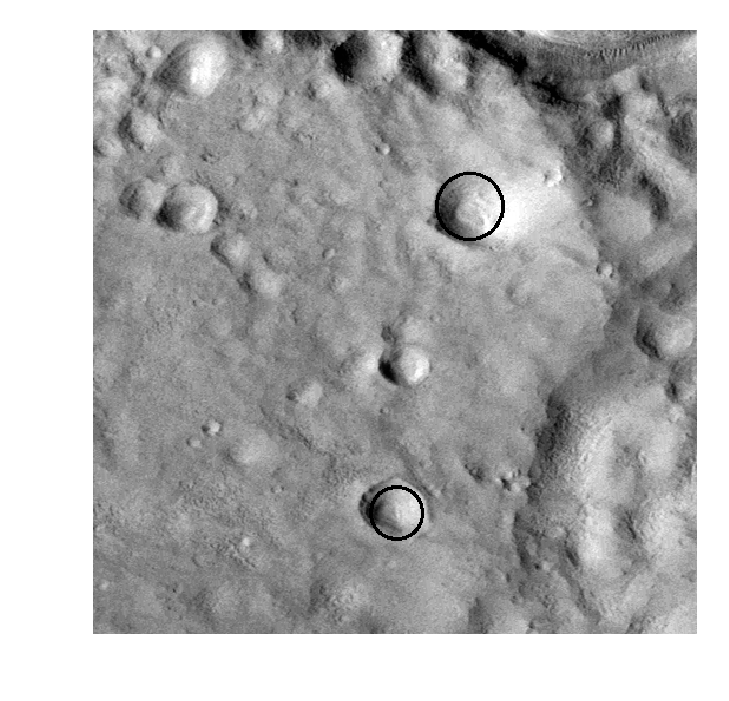

[[311.         215.          26.7298027 ]
 [381.         364.          23.27255835]]
(512, 512)


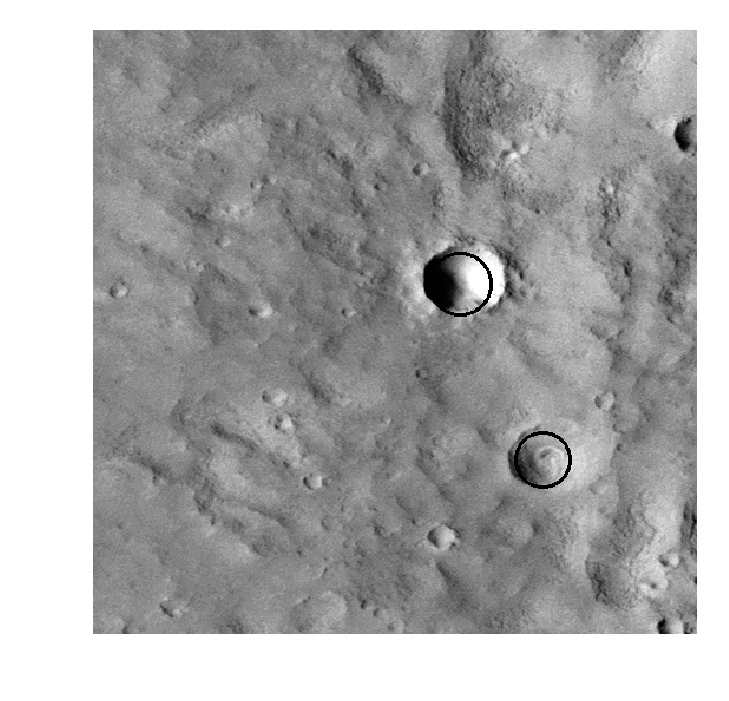

[[ 53.         233.          27.28309214]
 [134.         264.          22.31325677]
 [375.          54.          16.47011009]
 [231.         287.          20.01793847]]
(512, 512)


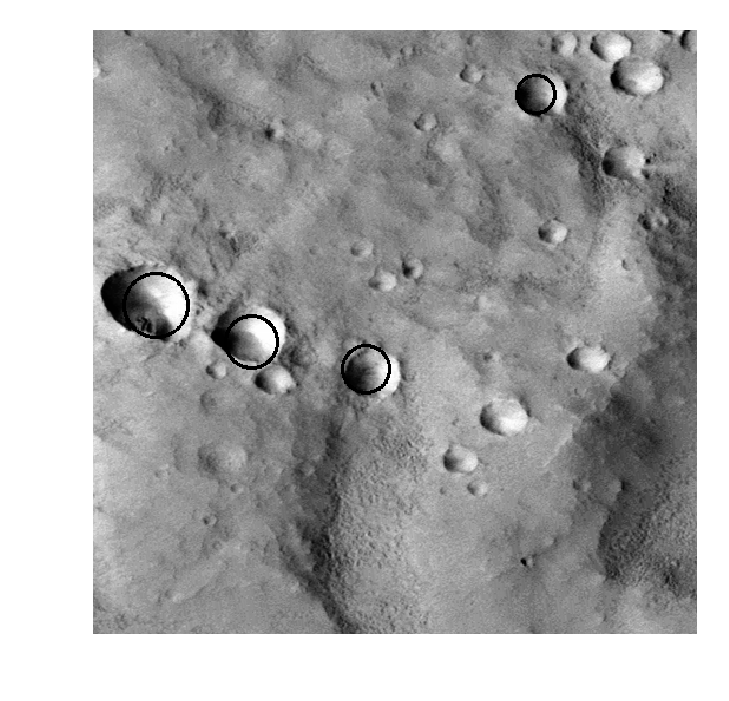

[215.         380.          20.92563757]
(512, 512)


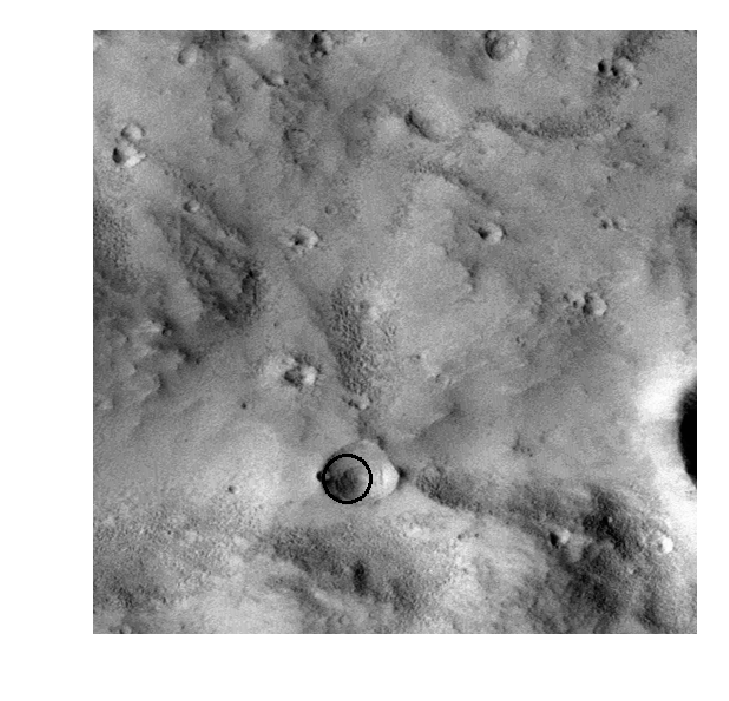

[[ 55.         300.          33.8717116 ]
 [251.         467.          40.71501191]
 [214.         339.           8.85101428]]
(512, 512)


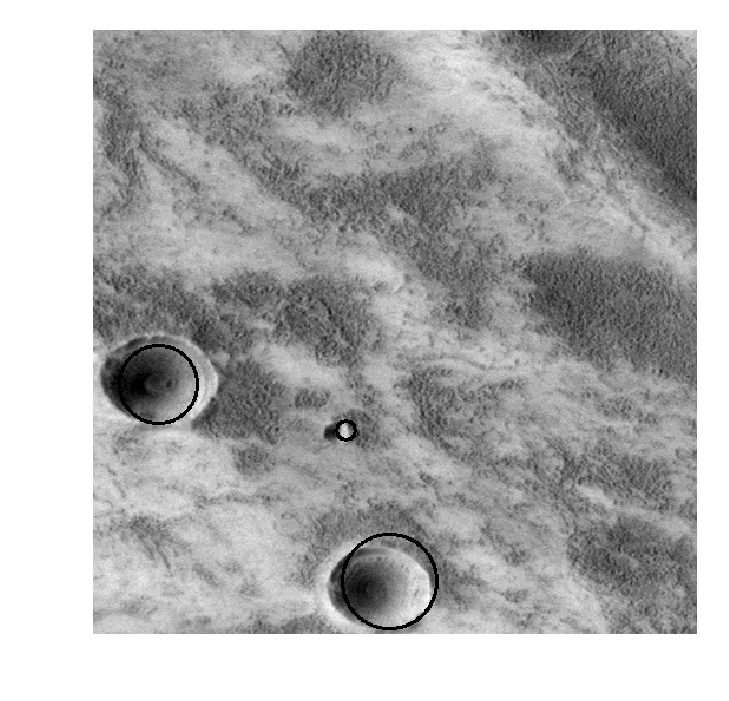

[[408.         156.          14.90929895]
 [423.         215.          11.26017346]
 [205.         478.           9.94359664]
 [ 79.         332.           7.51467868]]
(512, 512)


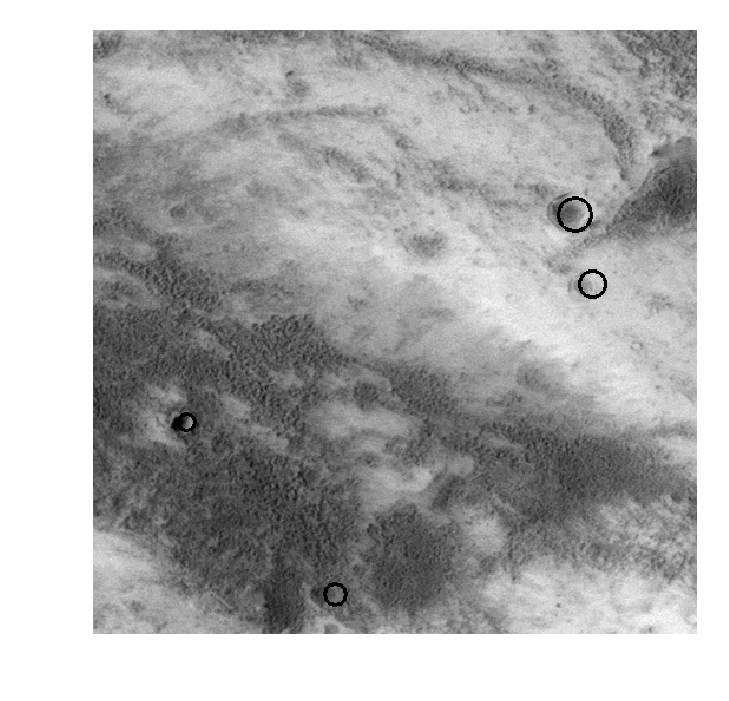

[[391.         163.          27.30083691]
 [487.         115.          23.54699187]
 [377.         399.           7.31326215]]
(512, 512)


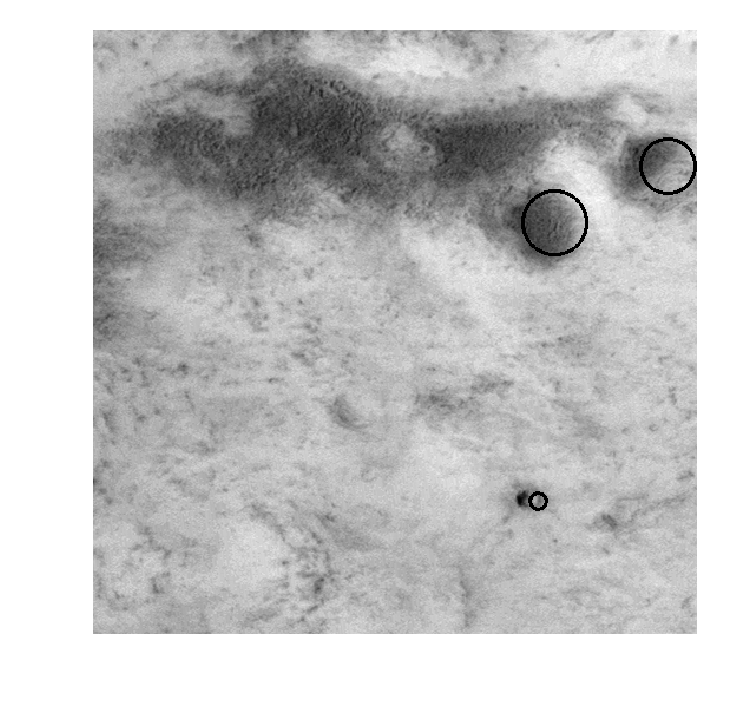

[[271.          23.           8.3522442 ]
 [281.         330.           8.39807109]]
(512, 512)


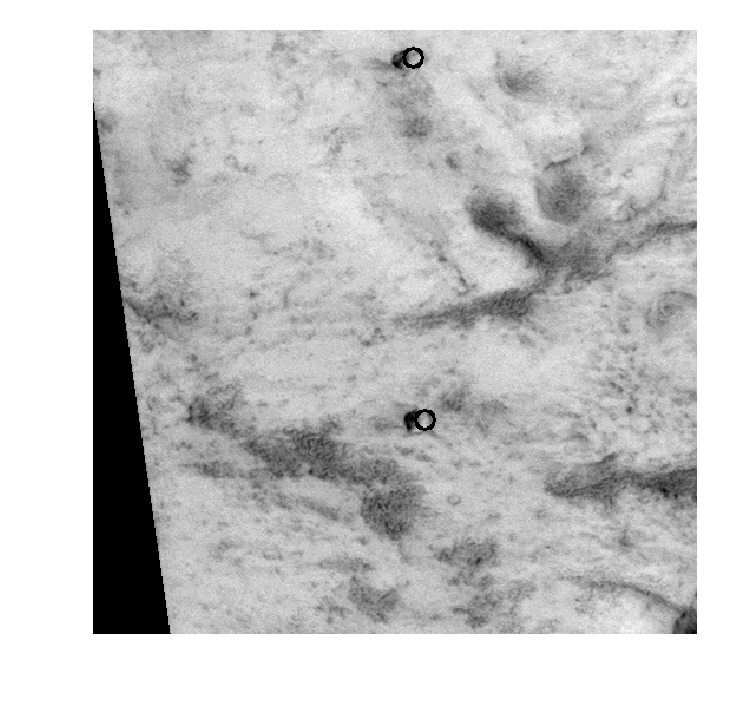

[[291.         409.          12.79291895]
 [412.         127.          52.47424872]]
(512, 512)


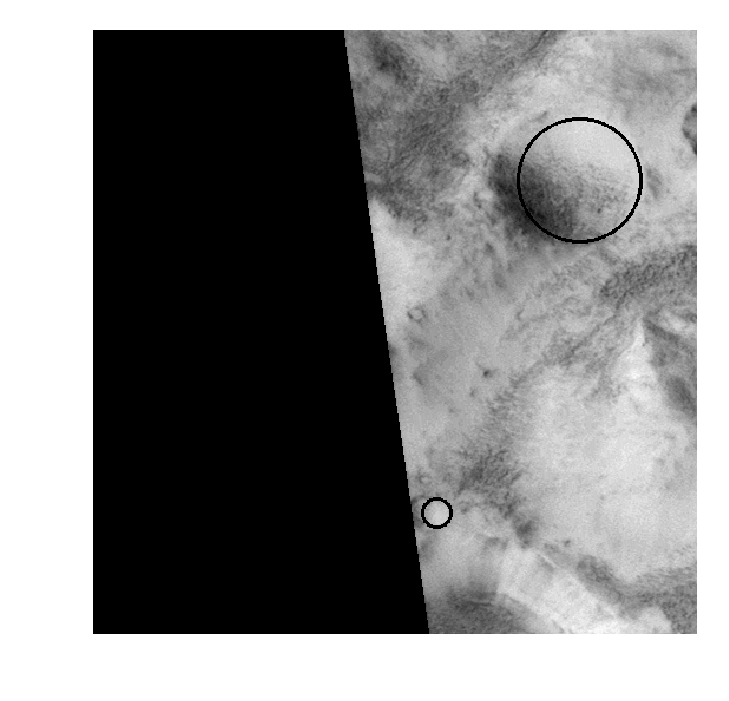

[403.          30.          27.96431951]
(512, 512)


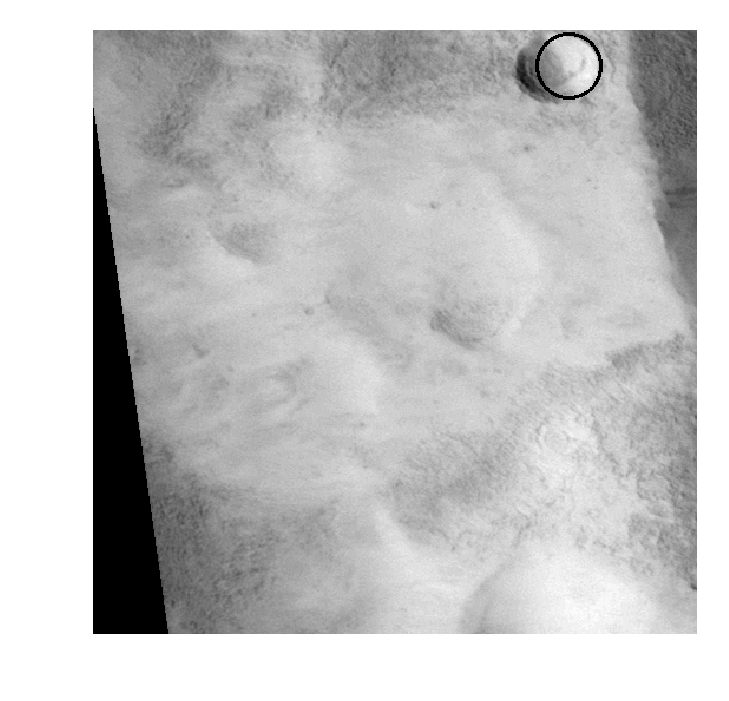

[508.         354.          30.85545751]
(512, 512)


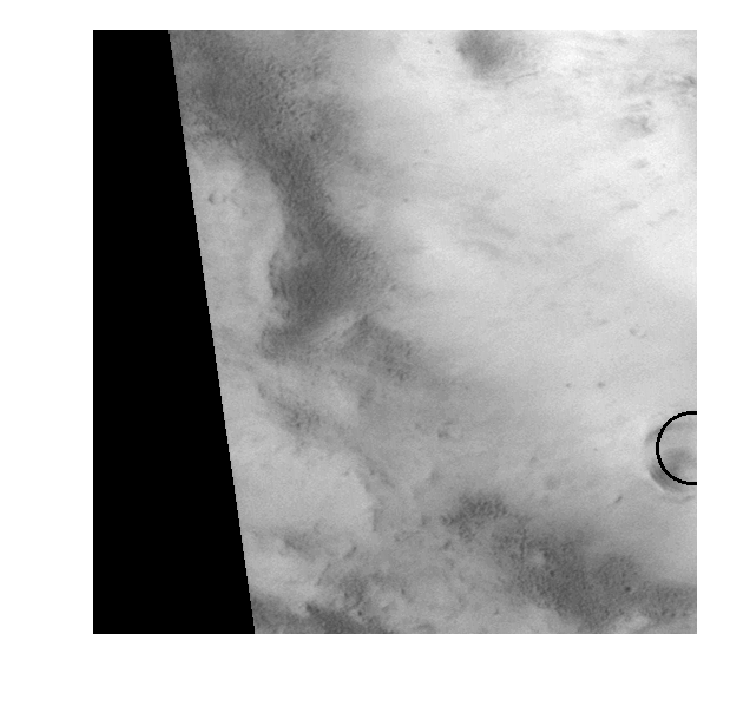

[[501.          29.          44.74784977]
 [383.          57.          47.23934685]]
(512, 512)


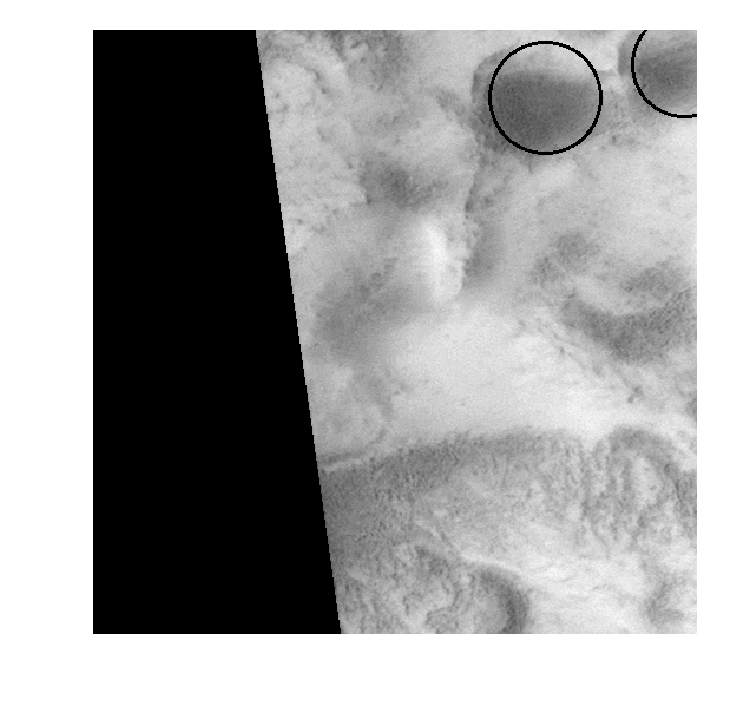

[440.         484.          43.97131317]
(512, 512)


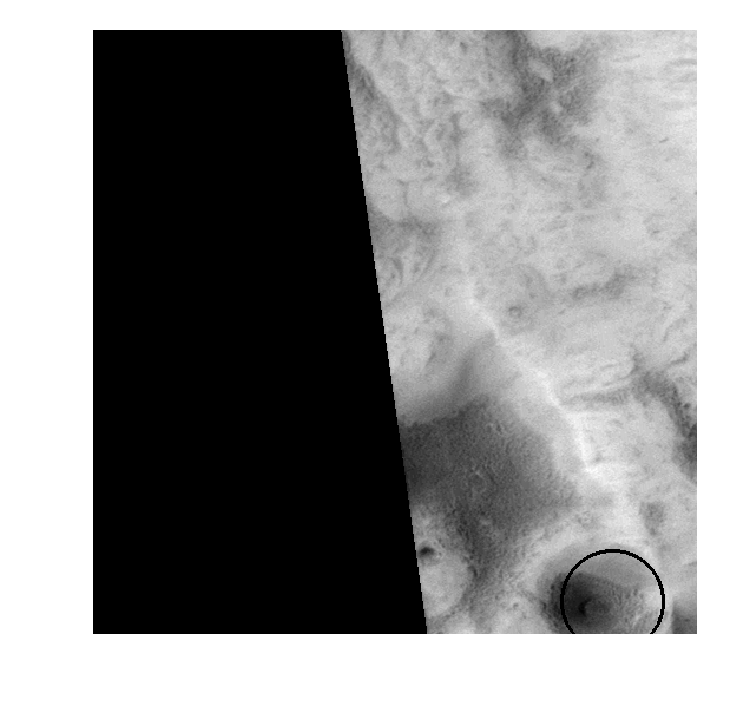

[364.         397.          25.60276747]
(512, 512)


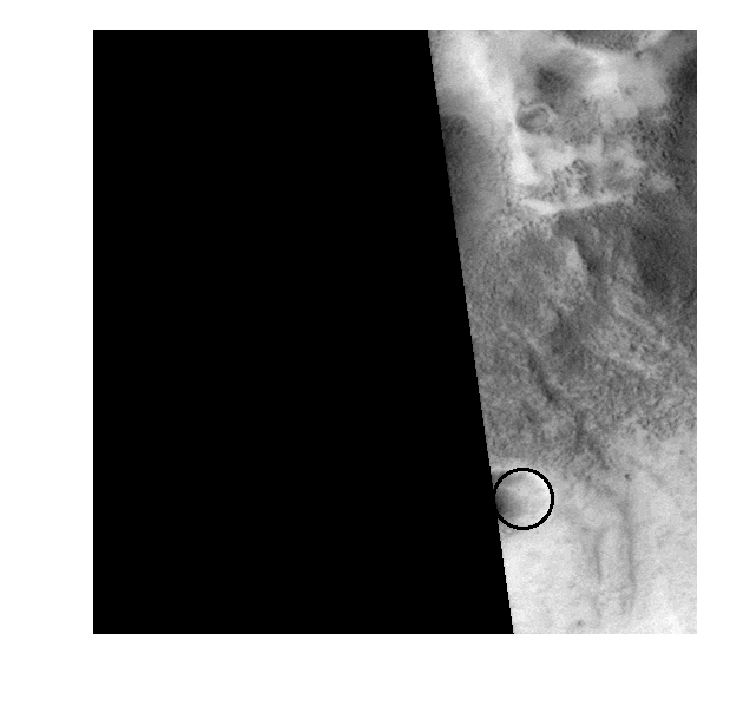

[[287.         343.           6.42418812]
 [402.         507.           4.67288905]]
(512, 512)


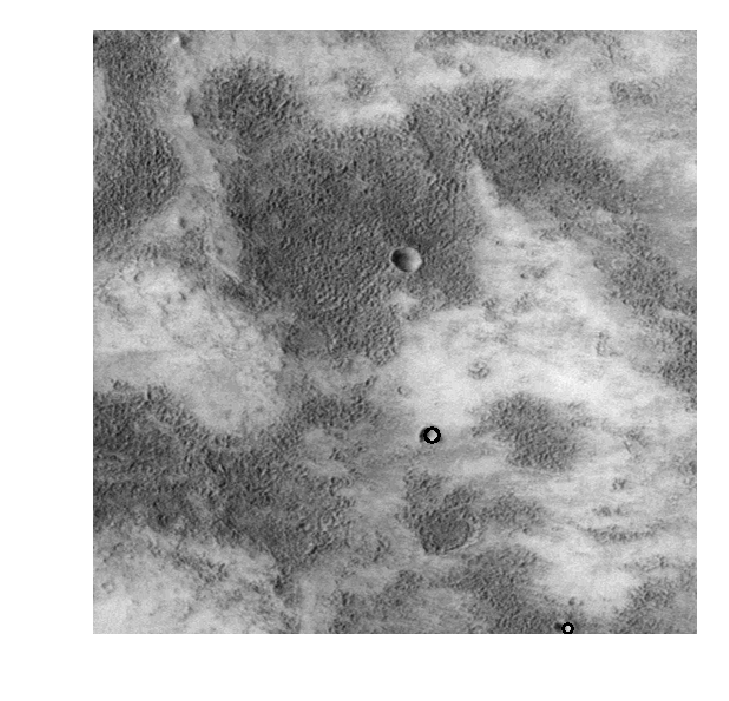

[[334.          13.          32.50215181]
 [393.          17.          14.83736491]
 [235.         273.          12.02705709]]
(512, 512)


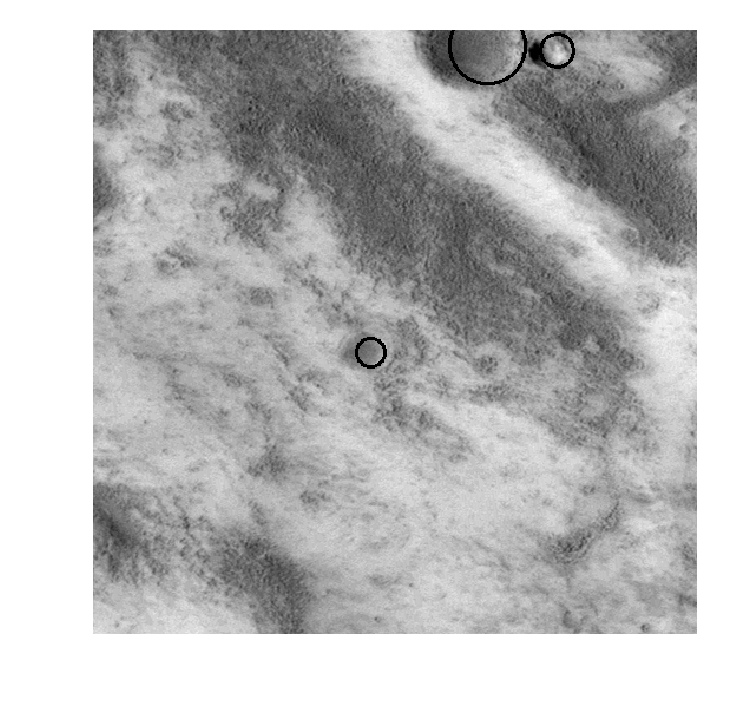

[452.        132.         86.5813623]
(512, 512)


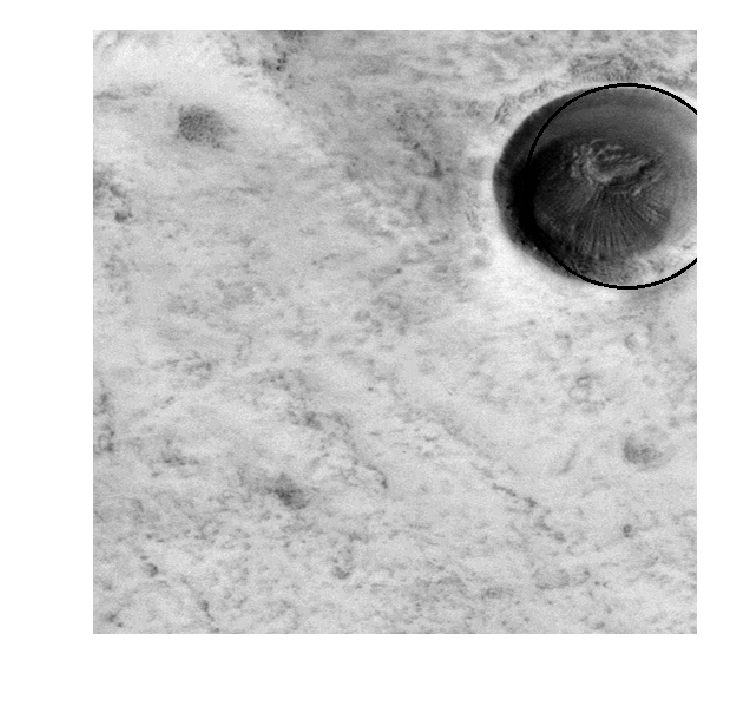

[[337.         258.          73.3795819 ]
 [421.         208.          17.84033489]]
(512, 512)


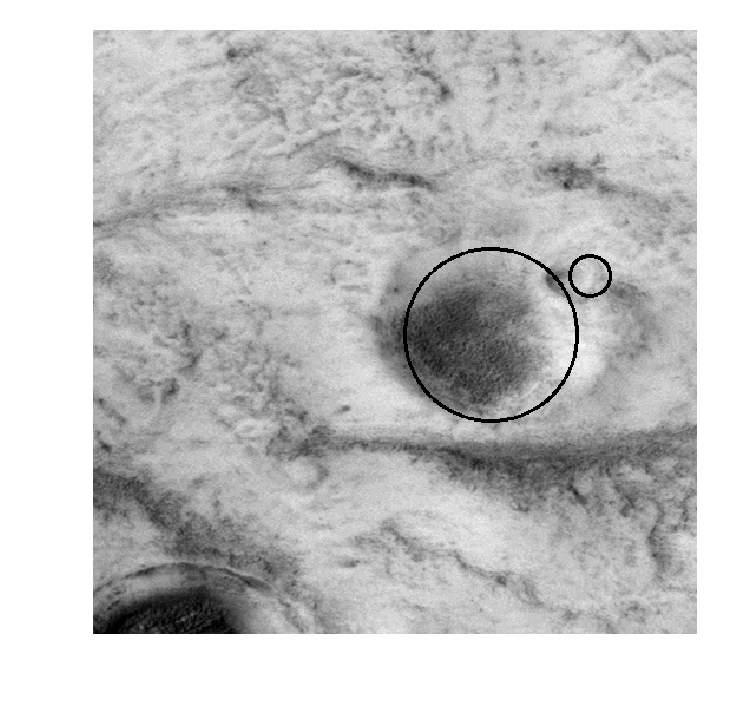

[[ 86.          33.          77.4097414 ]
 [484.          69.          53.69395318]
 [208.         136.           5.06454511]]
(512, 512)


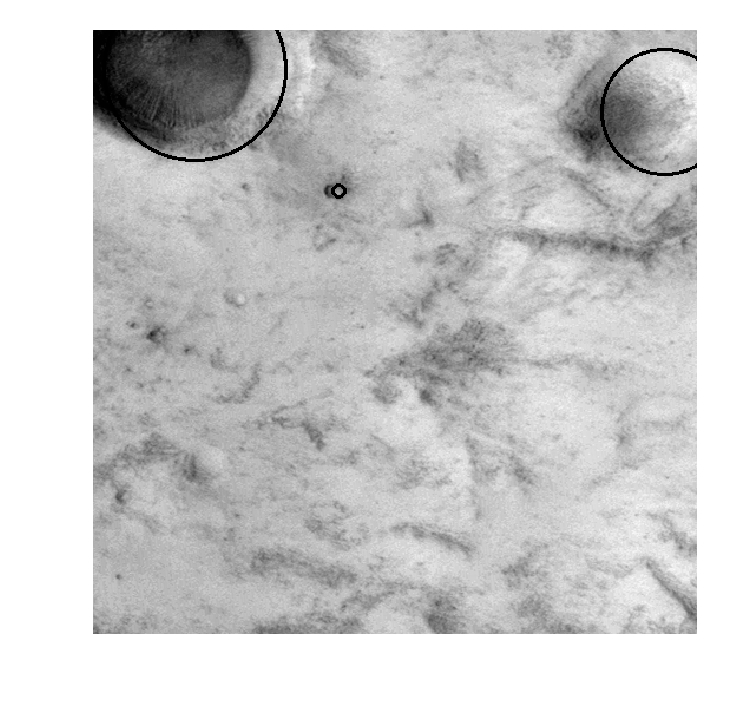

[45.         88.         36.59705025]
(512, 512)


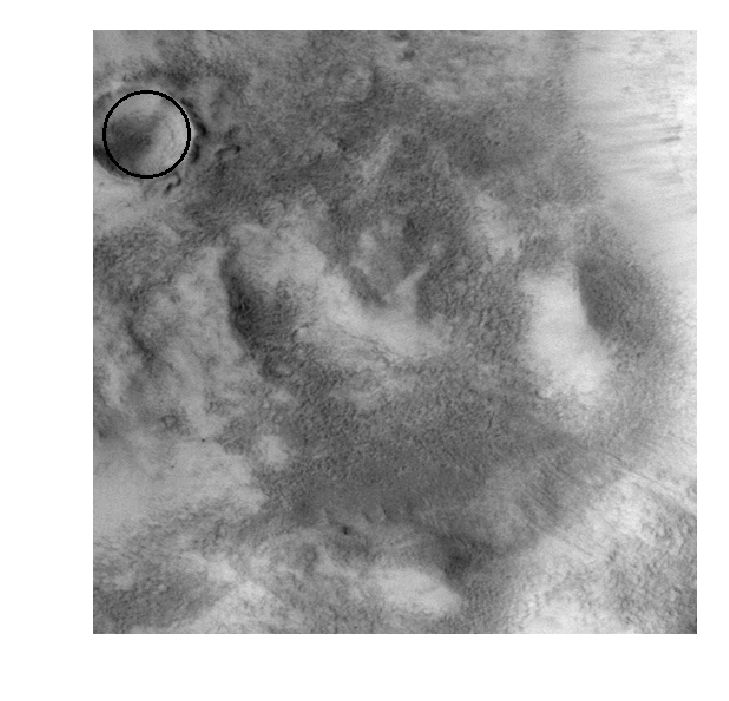

[[153.         113.          38.21673008]
 [ 30.         150.          40.44285191]
 [495.          93.           6.25129775]]
(512, 512)


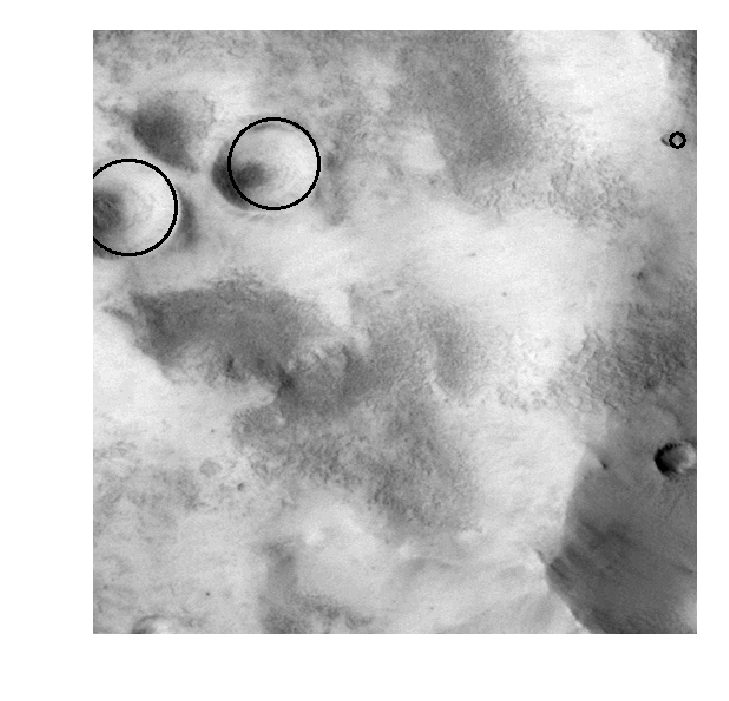

[  8.         468.           7.71019392]
(512, 512)


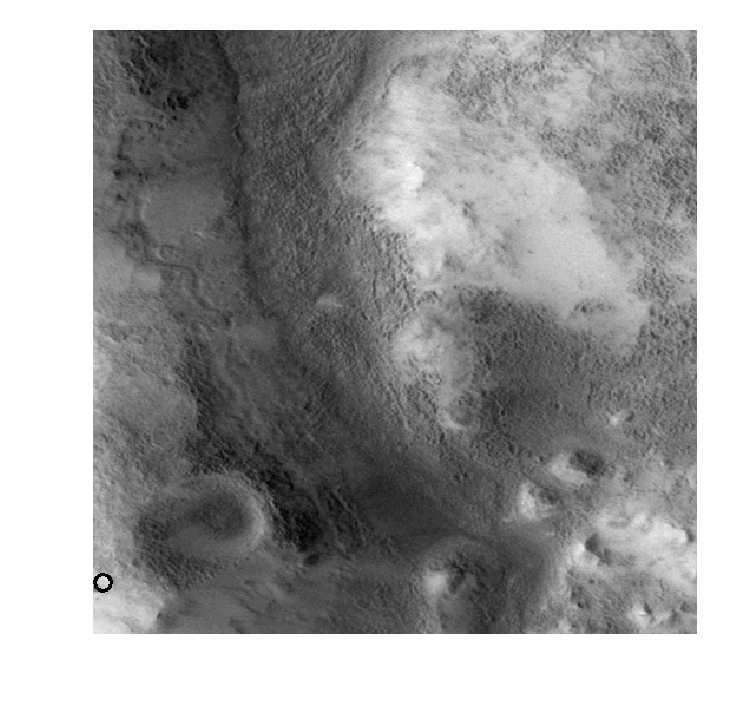

[ 22.         399.           8.76331323]
(512, 512)


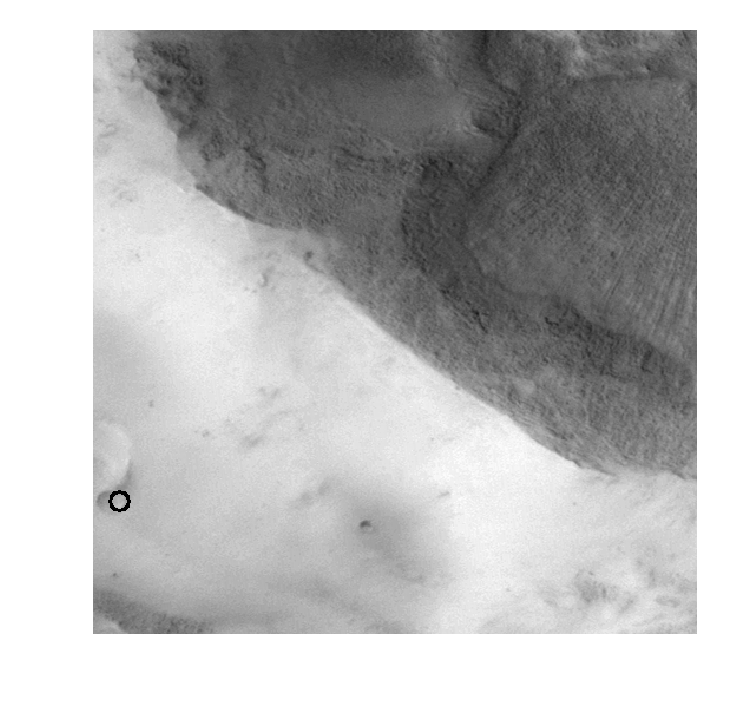

[ 66.         314.           8.96755649]
(512, 512)


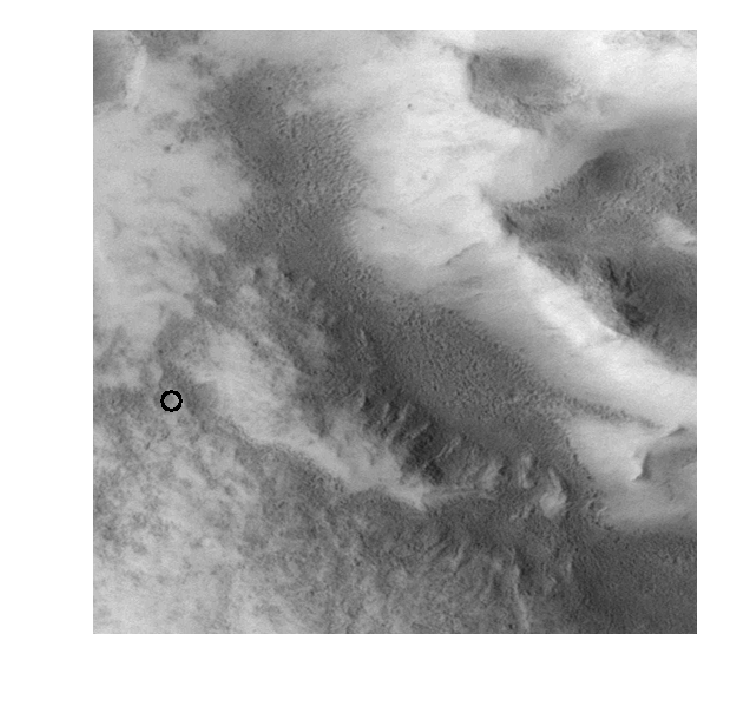

[[327.         117.          25.49339056]
 [209.         421.          55.87989993]
 [ 35.         363.          30.3199915 ]]
(512, 512)


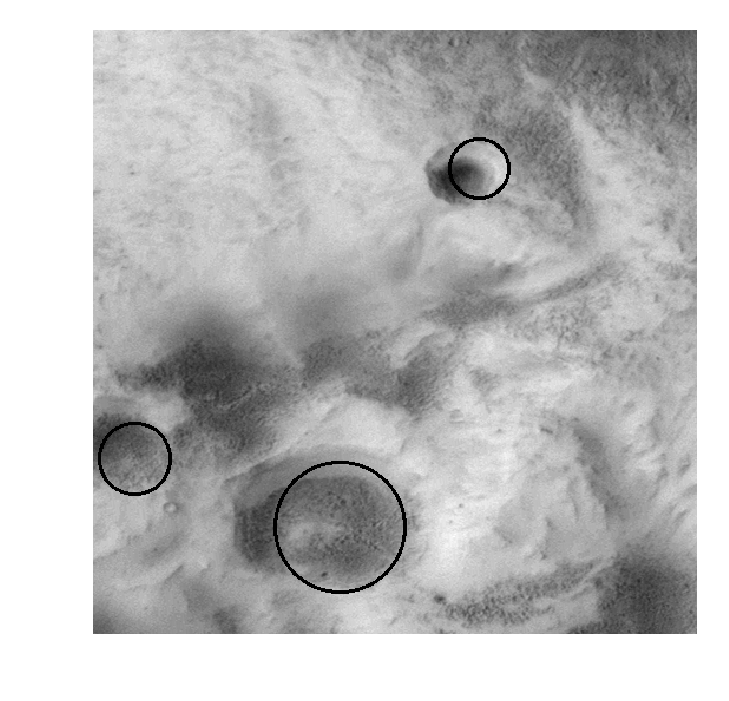

[[294.         449.          15.10688475]
 [331.         263.          10.26273029]
 [390.         395.           6.62334636]]
(512, 512)


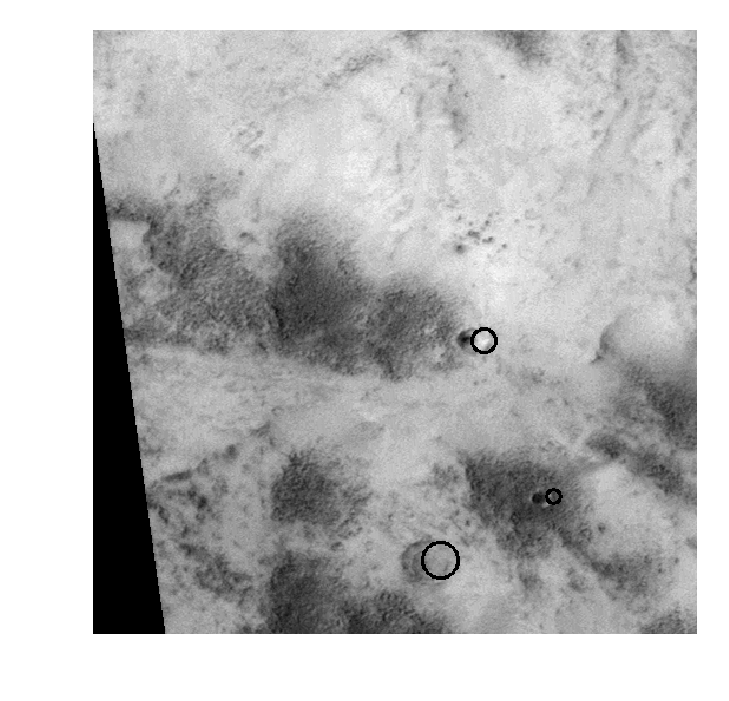

[[201.         116.          28.20097628]
 [478.         143.           6.85391511]]
(512, 512)


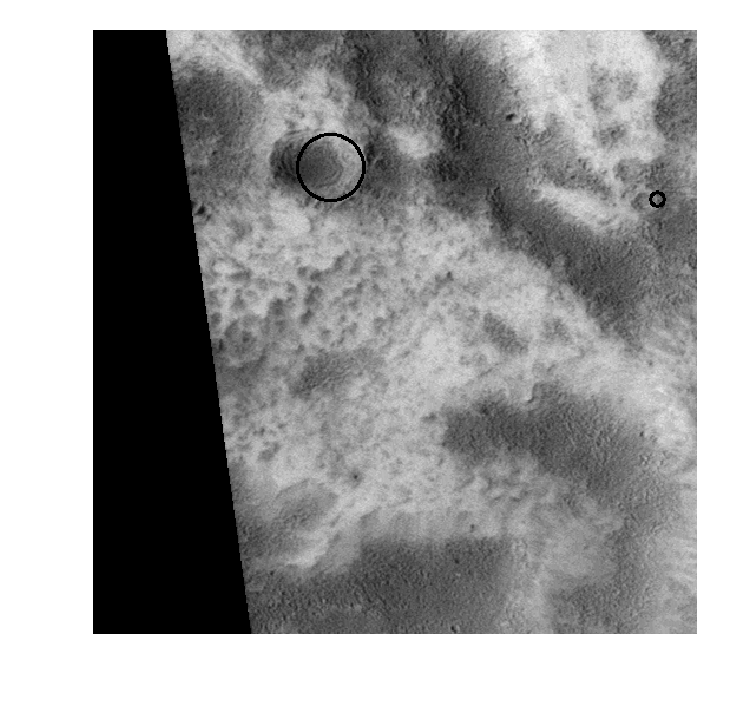

[416.         157.          13.01583926]
(512, 512)


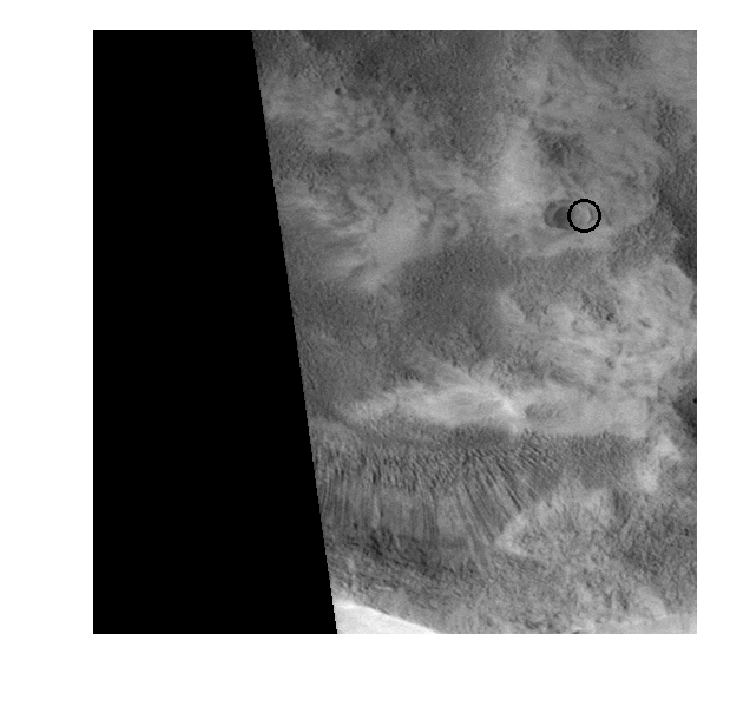

[[228.         290.          25.98028857]
 [494.         351.          25.16613965]]
(512, 512)


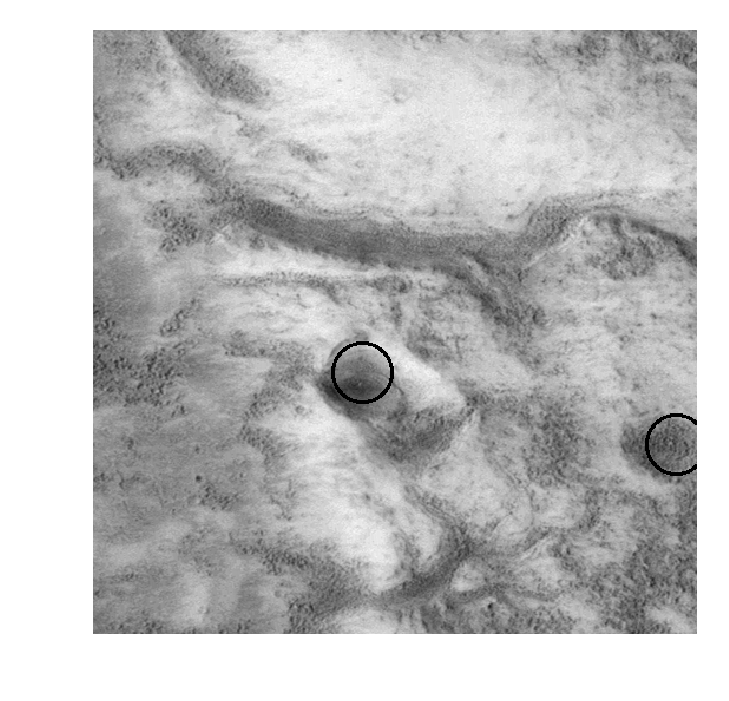

[[230.         500.          14.44384281]
 [406.         460.          22.1782691 ]]
(512, 512)


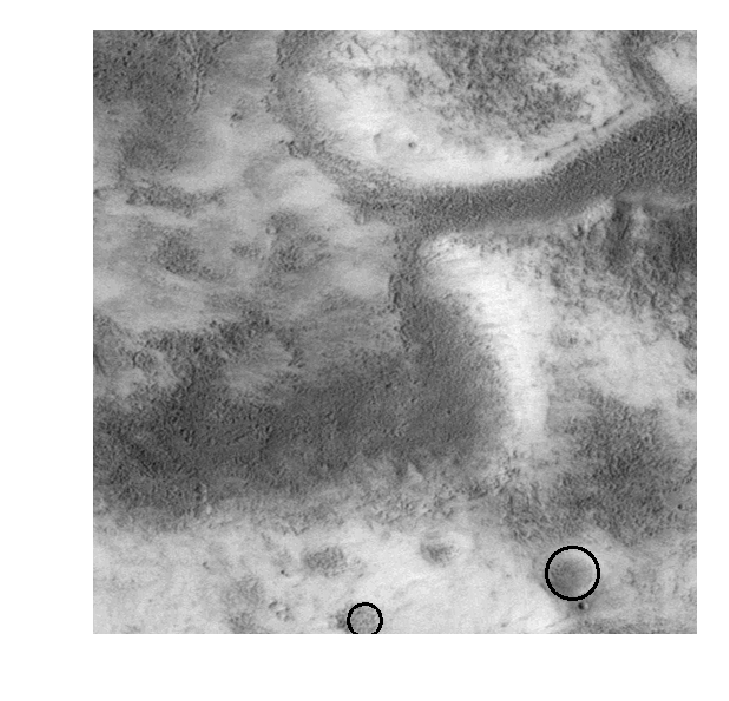

[ 75.         339.          33.48384295]
(512, 512)


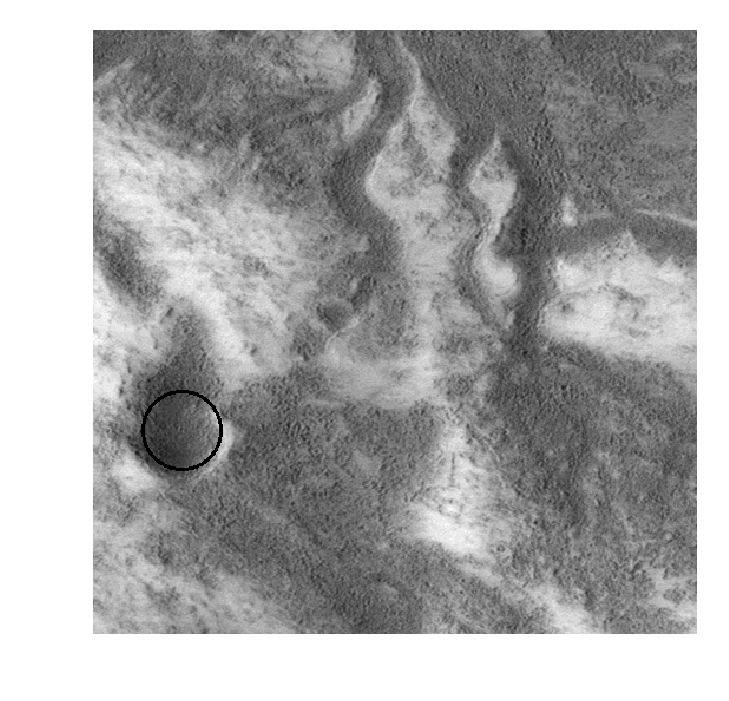

[132.           9.          17.66060049]
(512, 512)


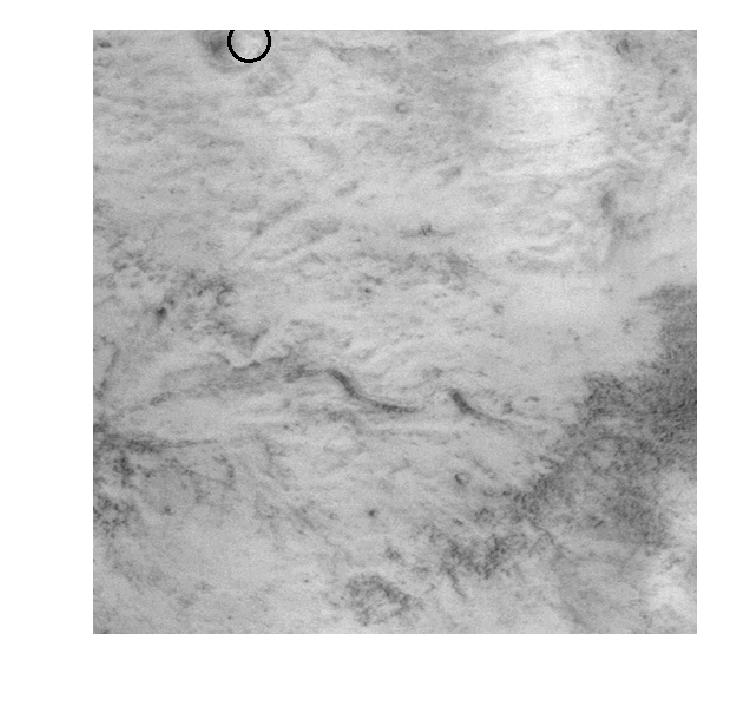

[386.         203.           8.06878568]
(512, 512)


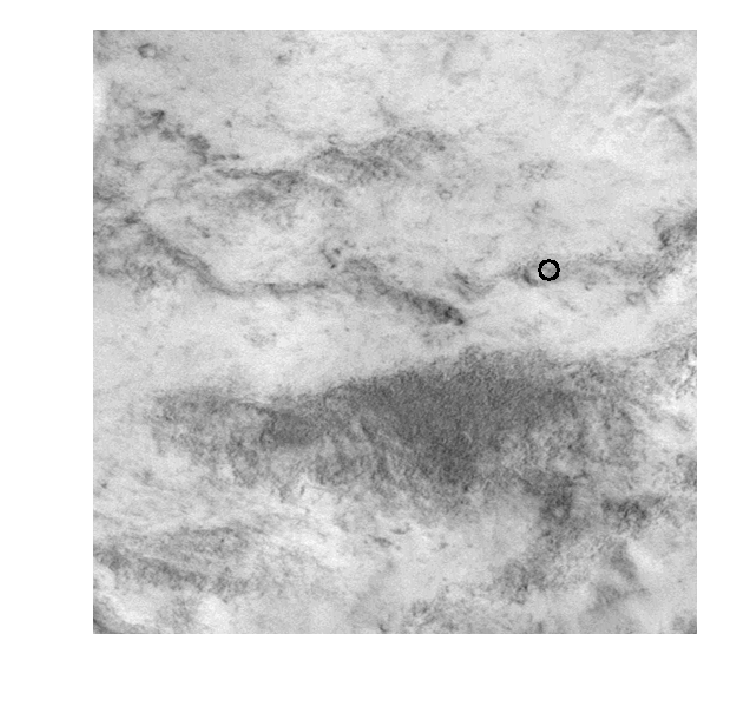

[427.         176.          12.46073419]
(512, 512)


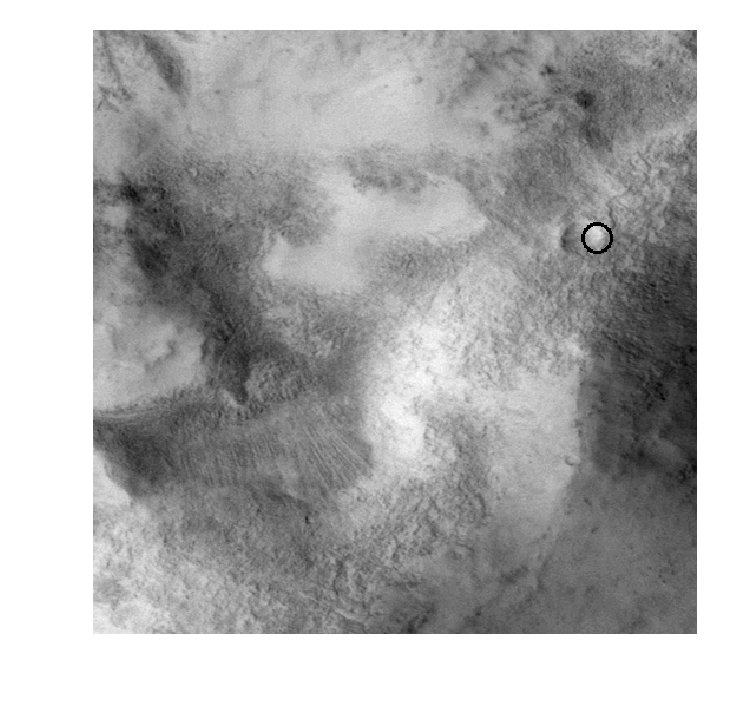

[274.         125.          35.47556382]
(512, 512)


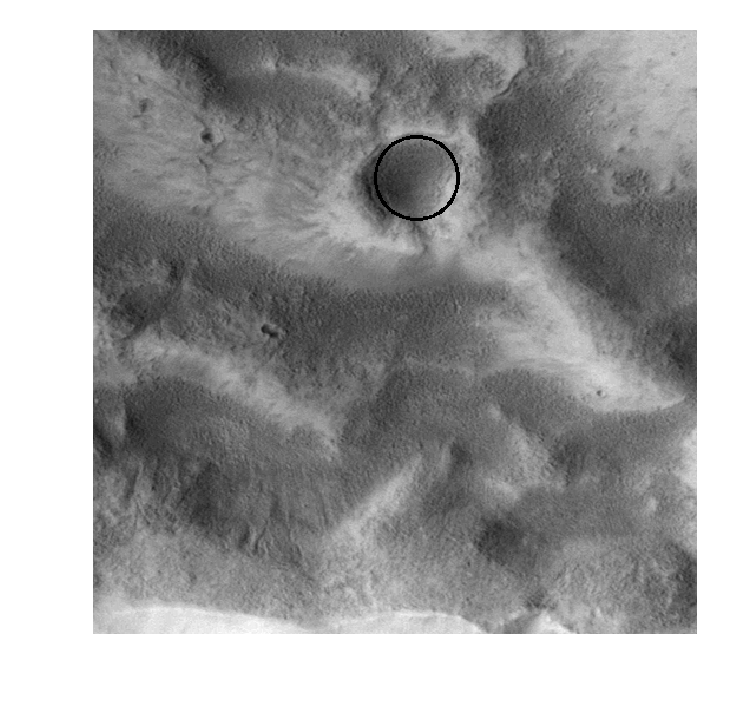

[[408.         459.          22.80141343]
 [258.          52.           4.3444428 ]]
(512, 512)


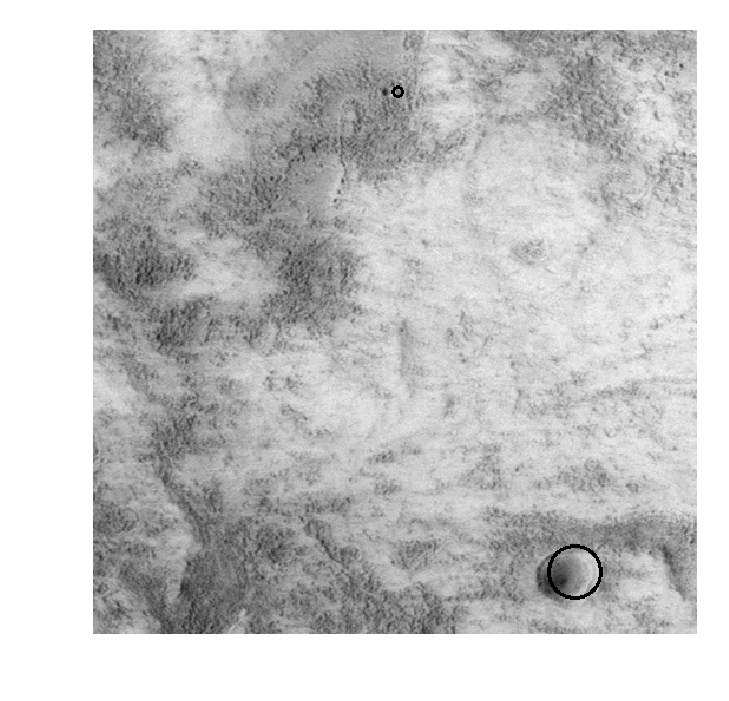

[[352.         164.          13.41314598]
 [124.         339.           6.4479367 ]]
(512, 512)


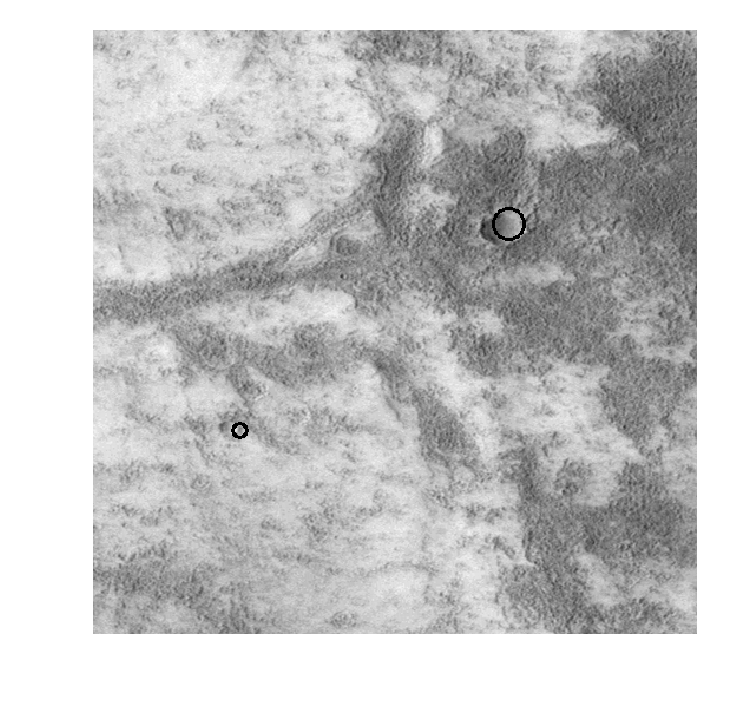

[[174.         449.          39.00836447]
 [281.          39.           5.30713626]
 [121.          75.          10.64371128]
 [508.         464.           4.46262281]]
(512, 512)


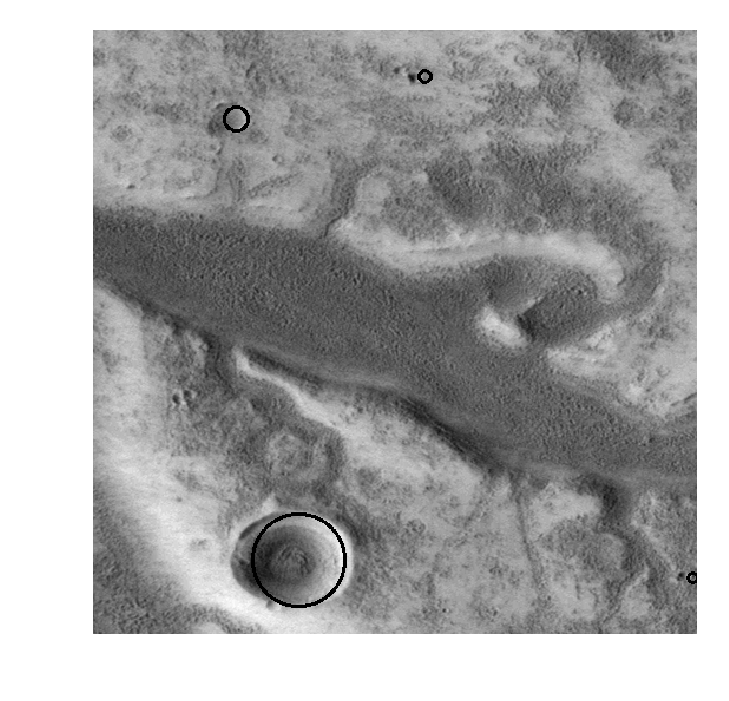

[[174.         107.          20.83666043]
 [152.         444.          20.94209975]
 [493.         310.          10.98571812]
 [118.         302.           7.81212889]]
(512, 512)


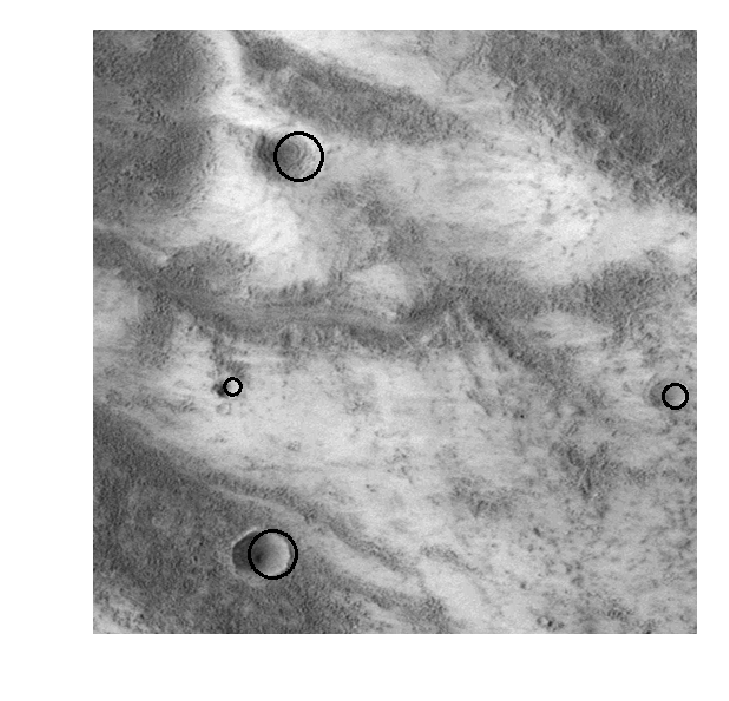

[31.          3.         15.68607679]
(512, 512)


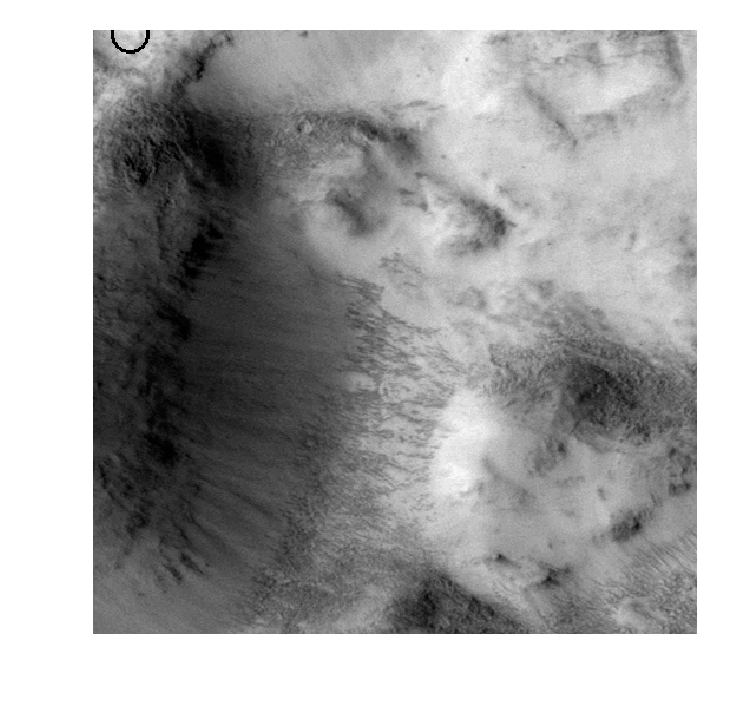

[[334.         348.          25.32131464]
 [505.         484.          13.69542101]]
(512, 512)


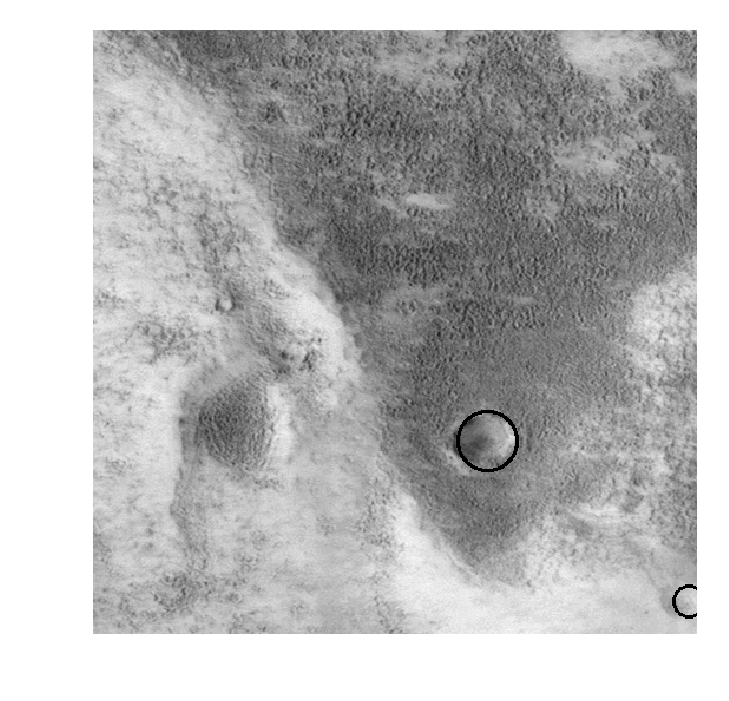

[373.         470.          19.19587614]
(512, 512)


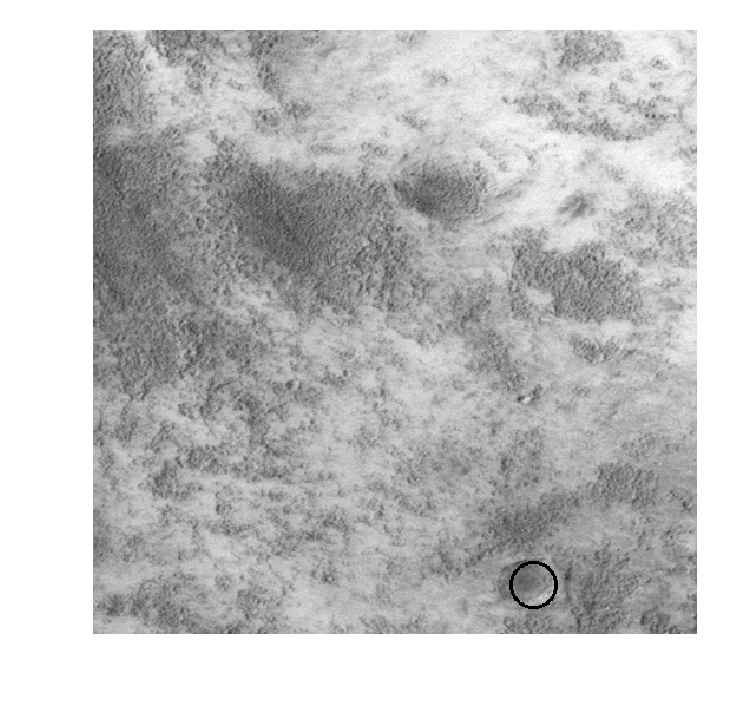

[[336.         276.          44.58120961]
 [441.         441.          17.24880642]
 [335.         470.           8.62189051]]
(512, 512)


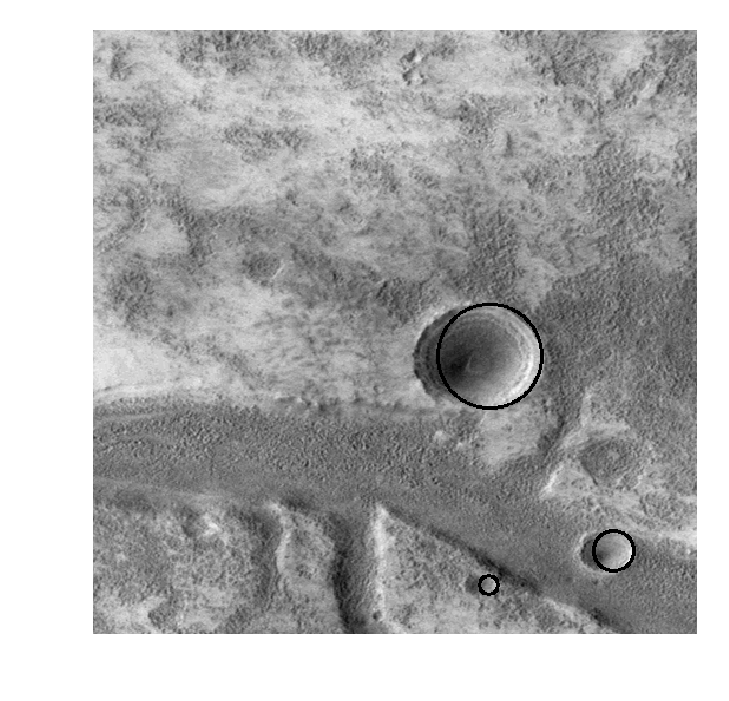

[[434.          50.          10.2831298 ]
 [ 45.         232.          12.83889816]]
(512, 512)


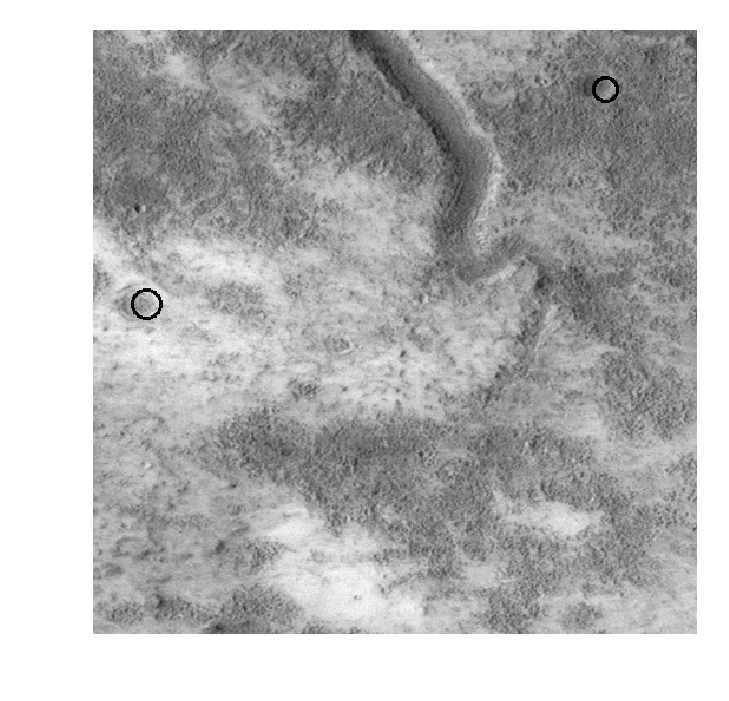

[302.         298.          39.47895618]
(512, 512)


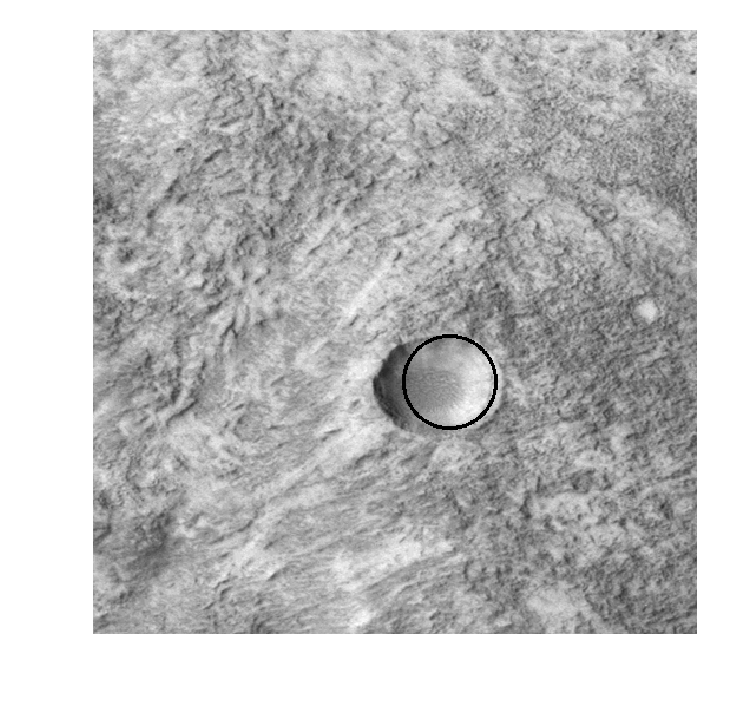

[294.         273.          18.25461927]
(512, 512)


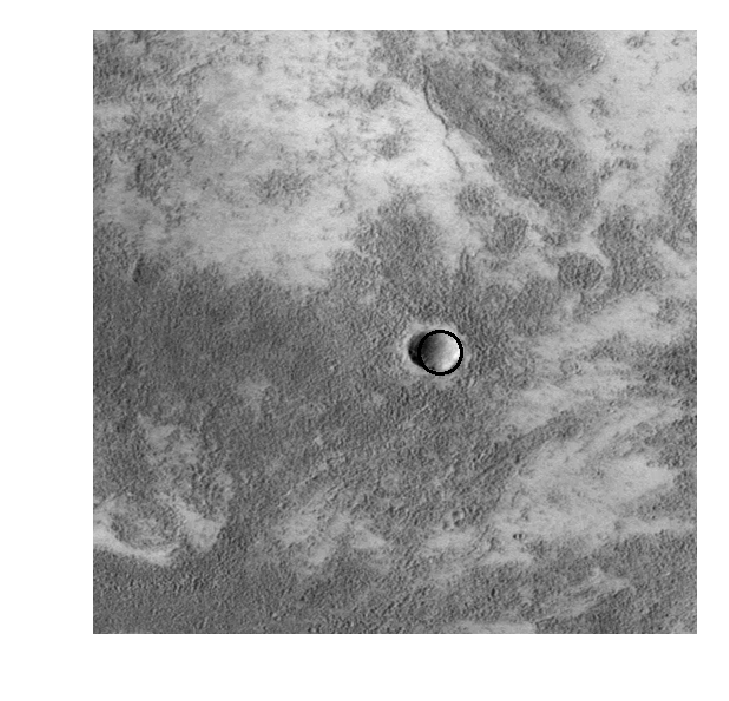

[295.         404.         105.66817984]
(512, 512)


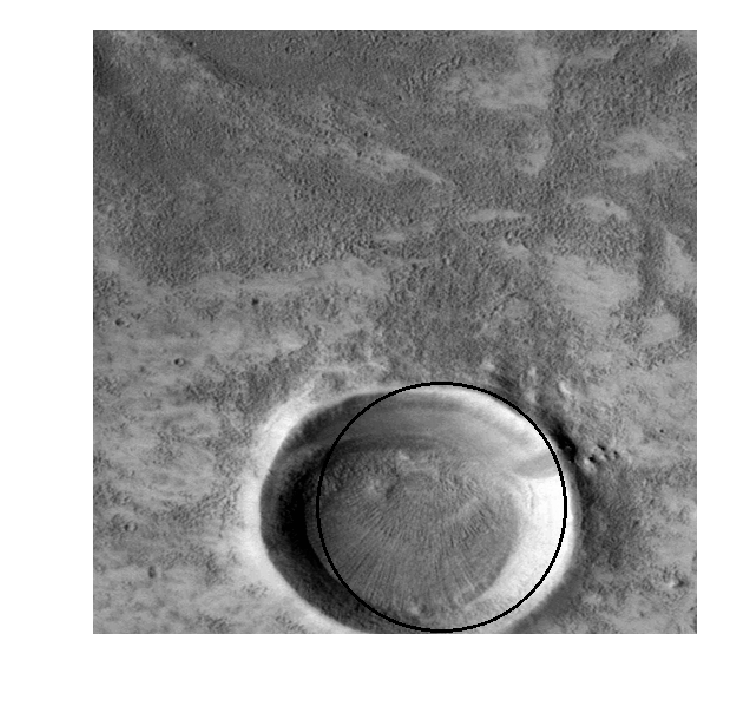

[136.         182.          38.42843389]
(512, 512)


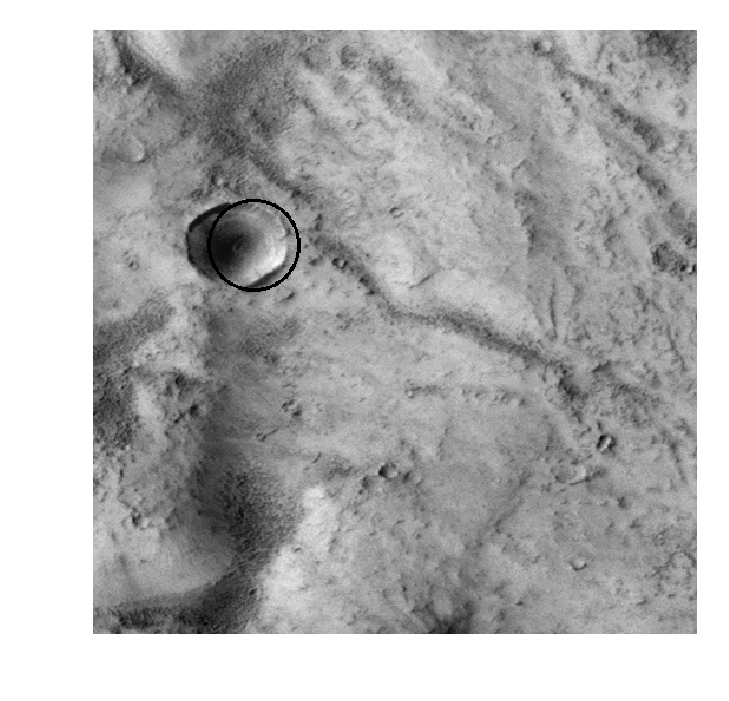

[122.         265.          33.58076553]
(512, 512)


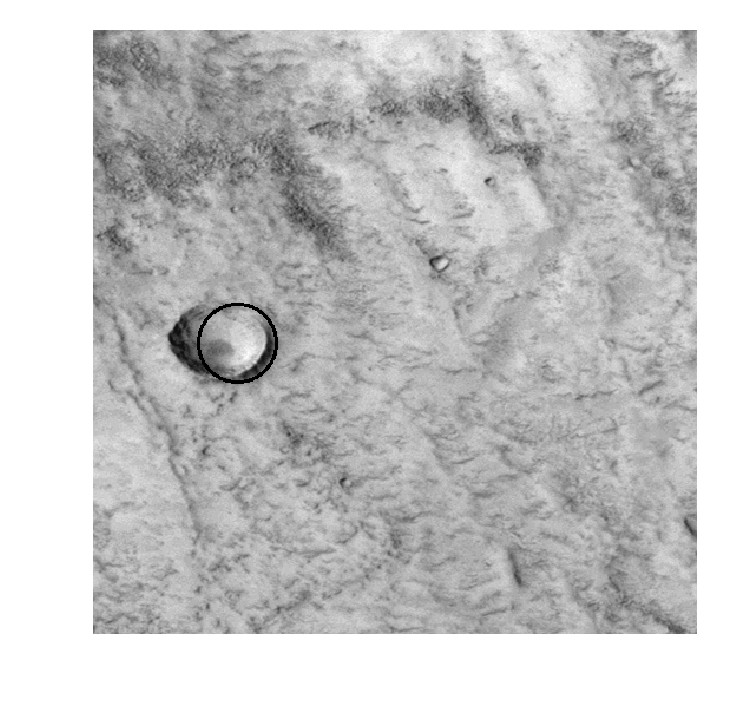

[494.         424.         194.70598259]
(512, 512)


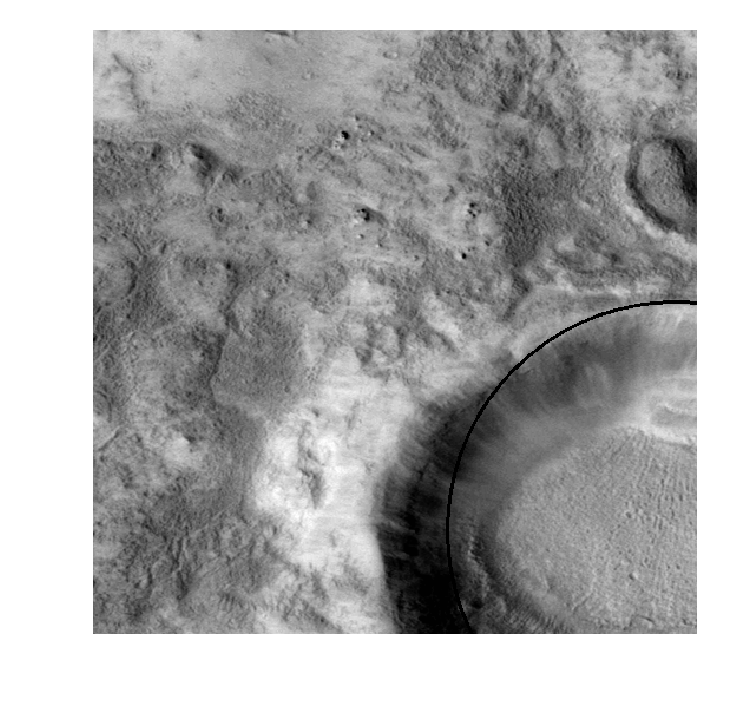

[170.         252.         239.41481309]
(512, 512)


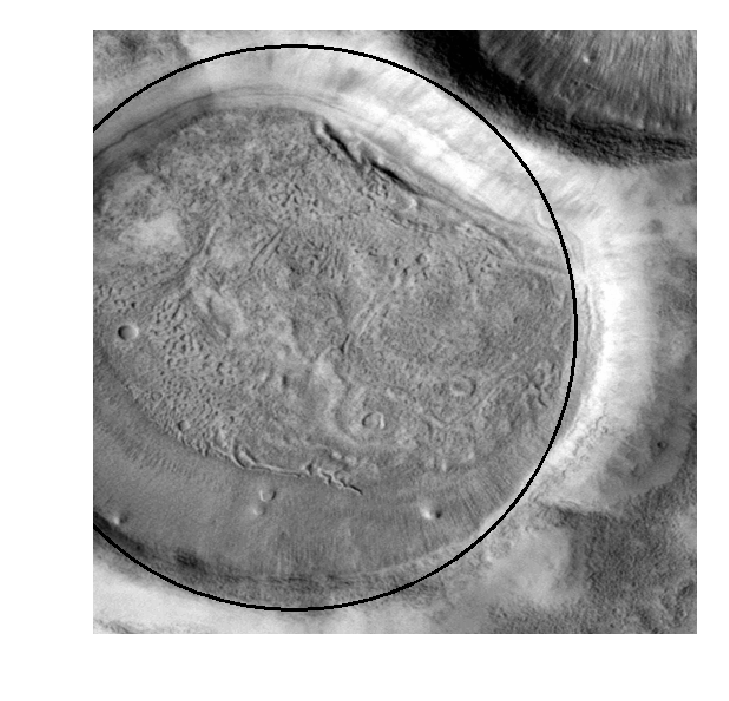

[[455.          30.          18.8975871 ]
 [509.         187.           8.95071418]
 [ 55.          58.           6.47936499]]
(512, 512)


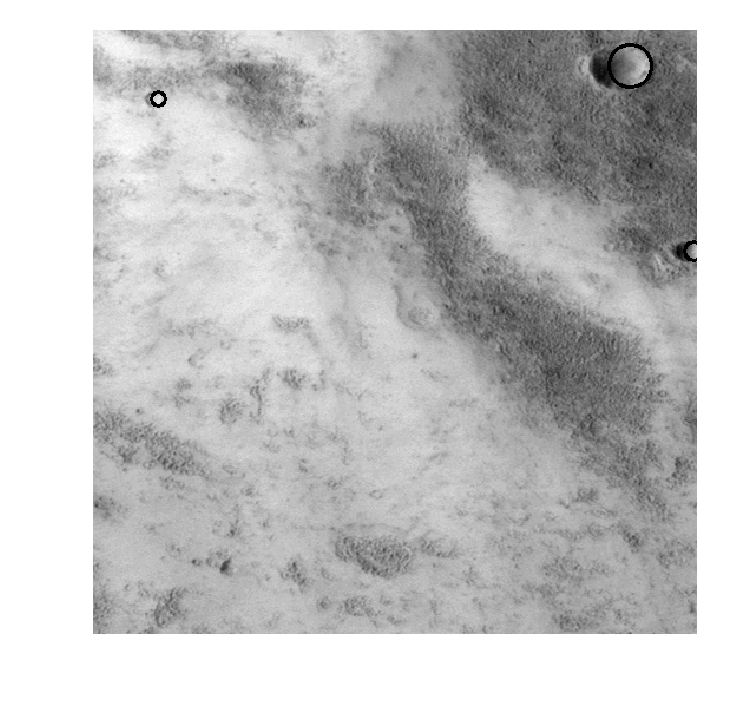

[ 49.         129.          29.30419041]
(512, 512)


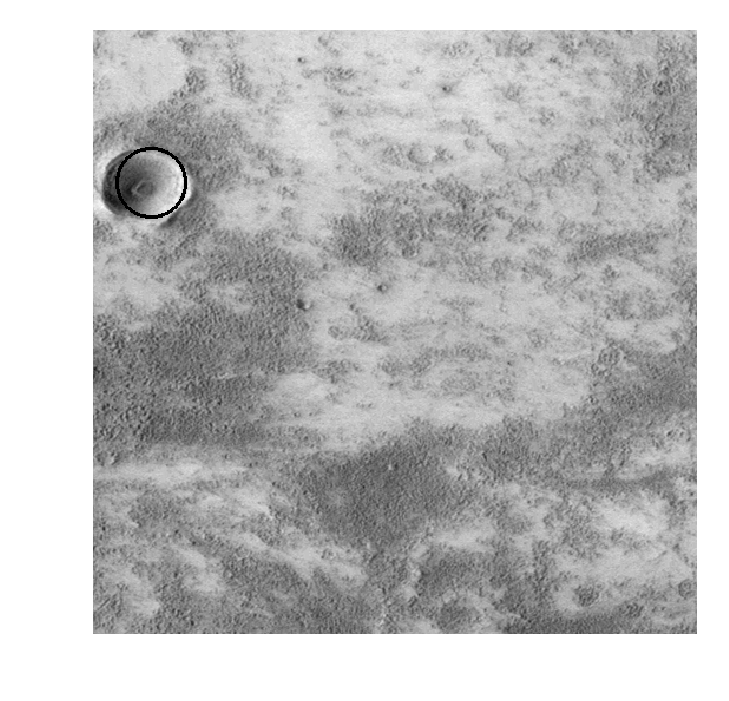

[[289.         414.           6.06055663]
 [125.         360.           5.39457927]]
(512, 512)


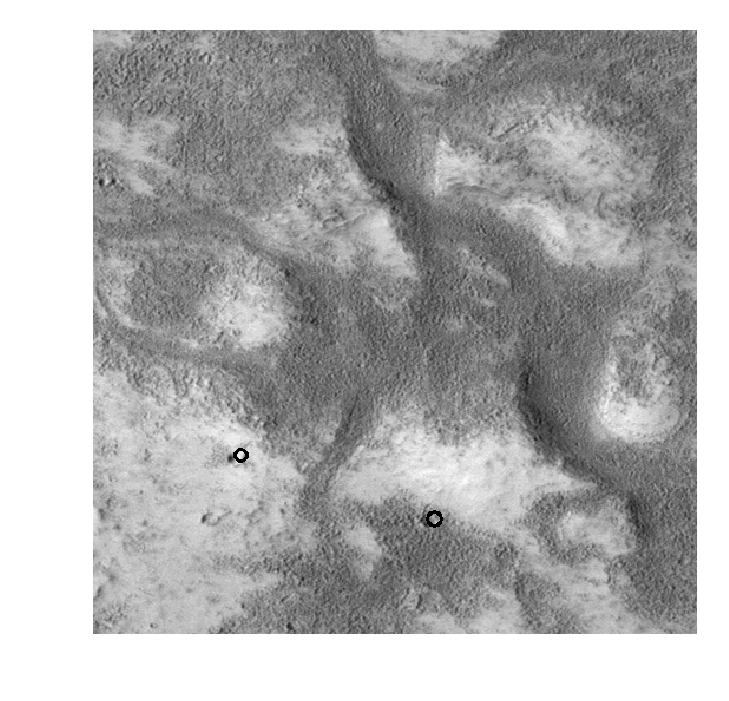

[[208.         311.           6.26335259]
 [182.         313.           9.79782744]
 [331.         212.          15.64983634]]
(512, 512)


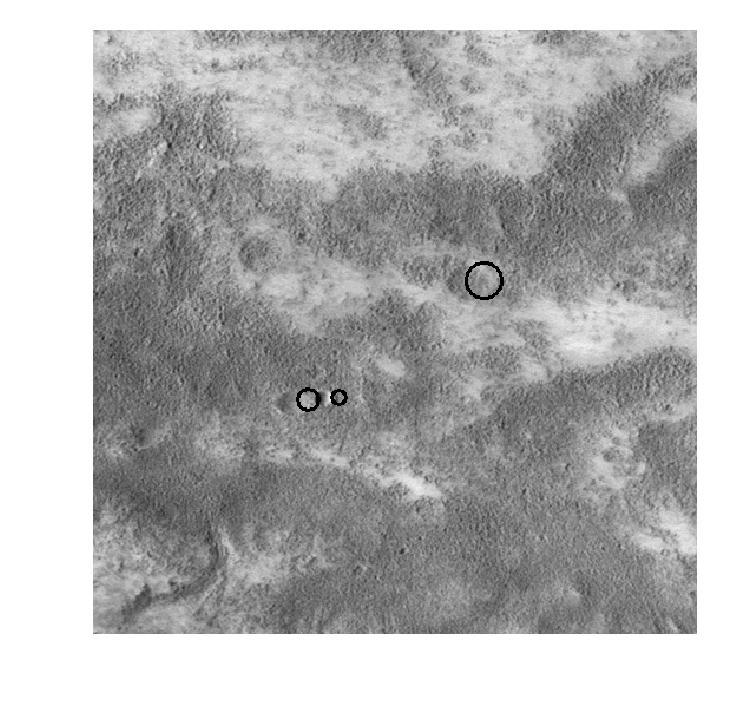

[23.        50.        19.9487829]
(512, 512)


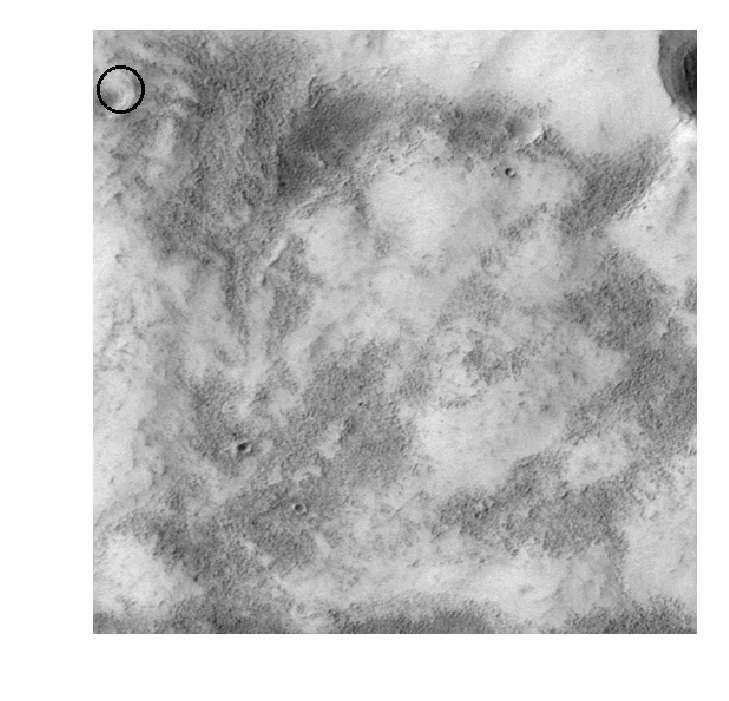

[[ 17.         482.          16.51881994]
 [213.         438.           7.72620085]]
(512, 512)


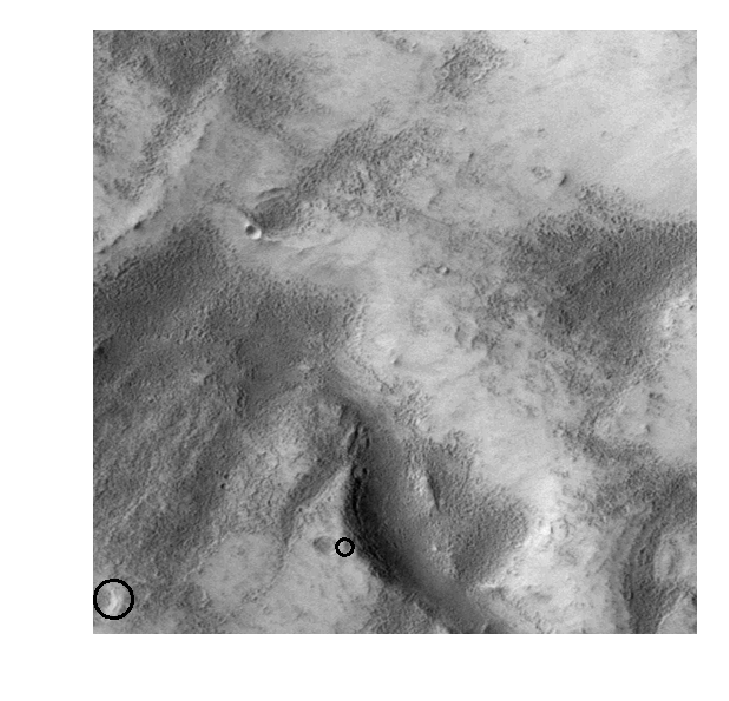

[491.         313.           8.96150387]
(512, 512)


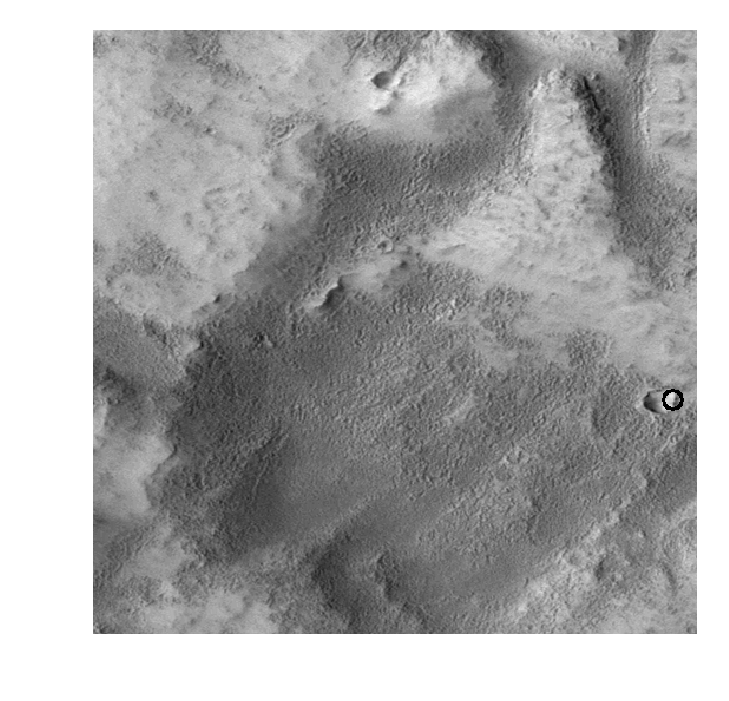

[[291.         284.          13.28544012]
 [192.         152.          10.48875019]]
(512, 512)


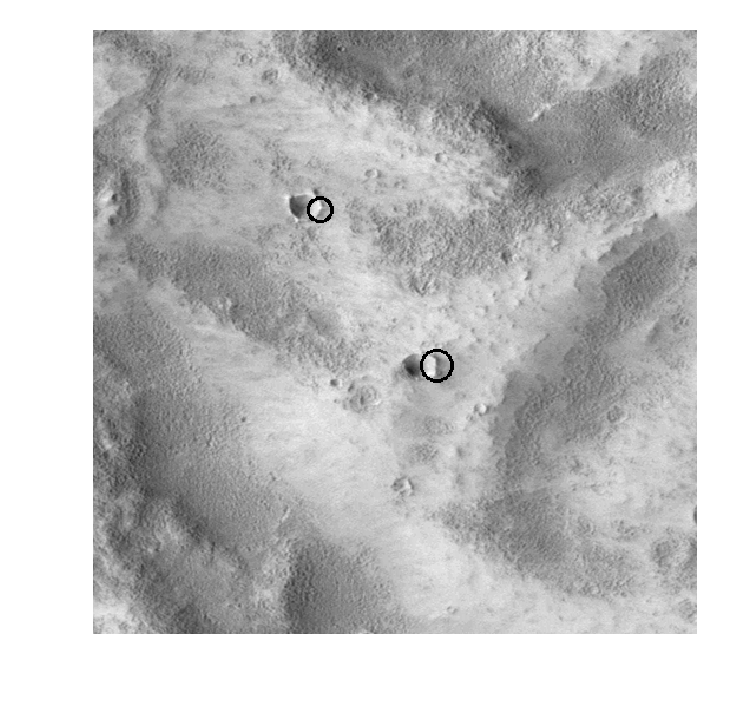

[[436.         414.          14.55248513]
 [245.           7.           8.70980414]]
(512, 512)


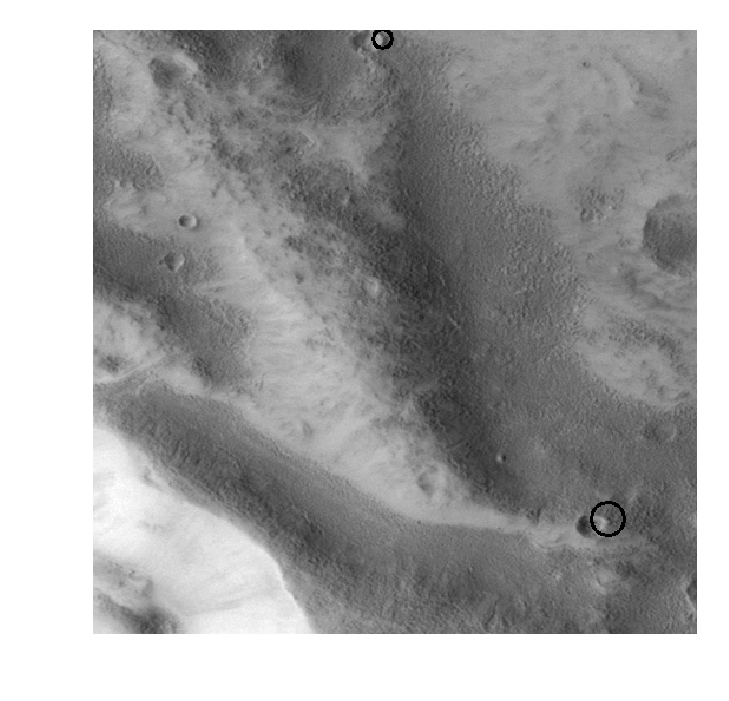

[242.         236.          22.32524055]
(512, 512)


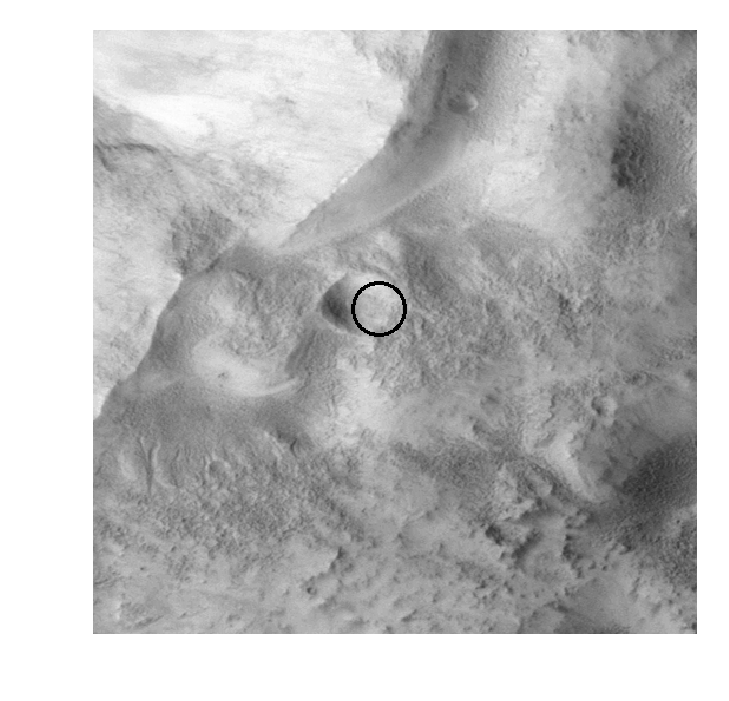

[260.         395.          39.61685875]
(512, 512)


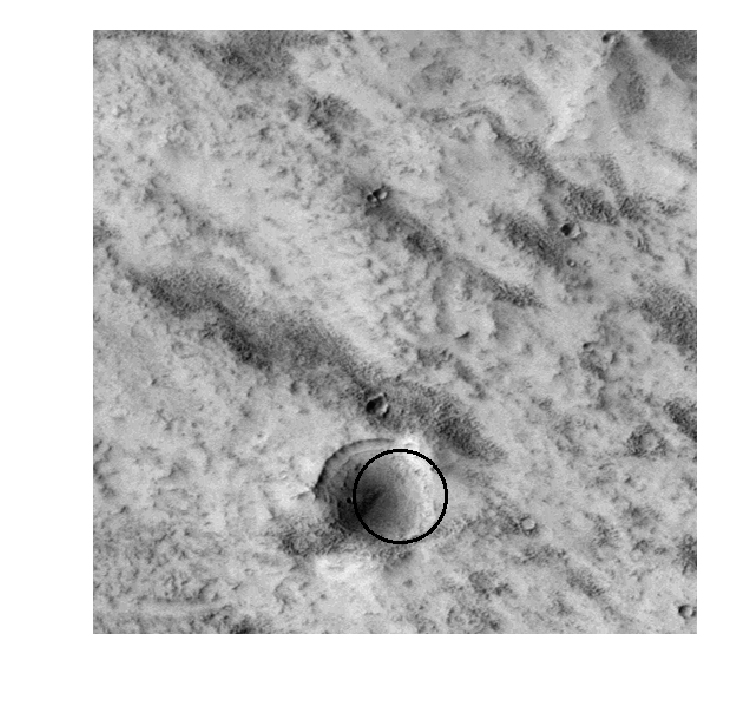

[[ 16.         324.           9.57645437]
 [498.         276.          15.35583251]]
(512, 512)


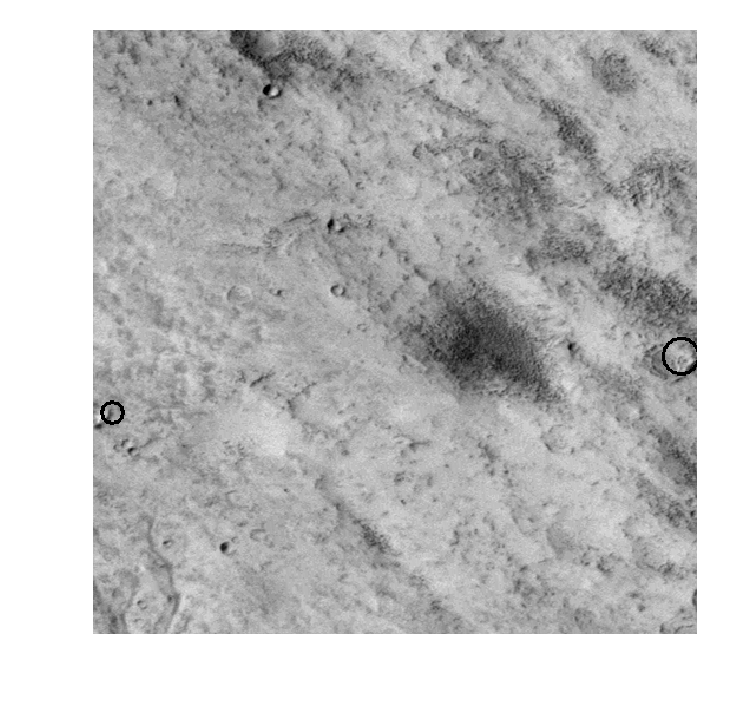

[240.         287.          18.53323928]
(512, 512)


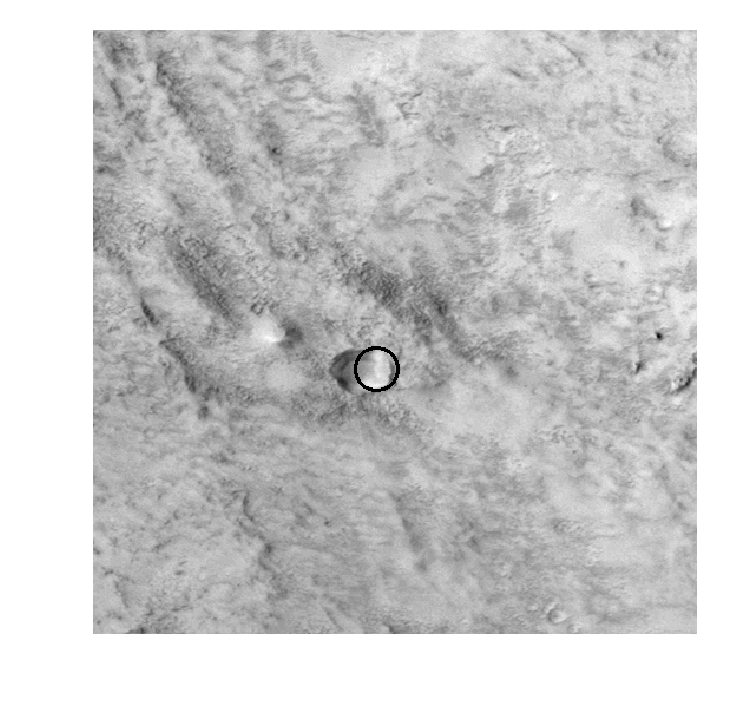

[  4.        124.         44.7044185]
(512, 512)


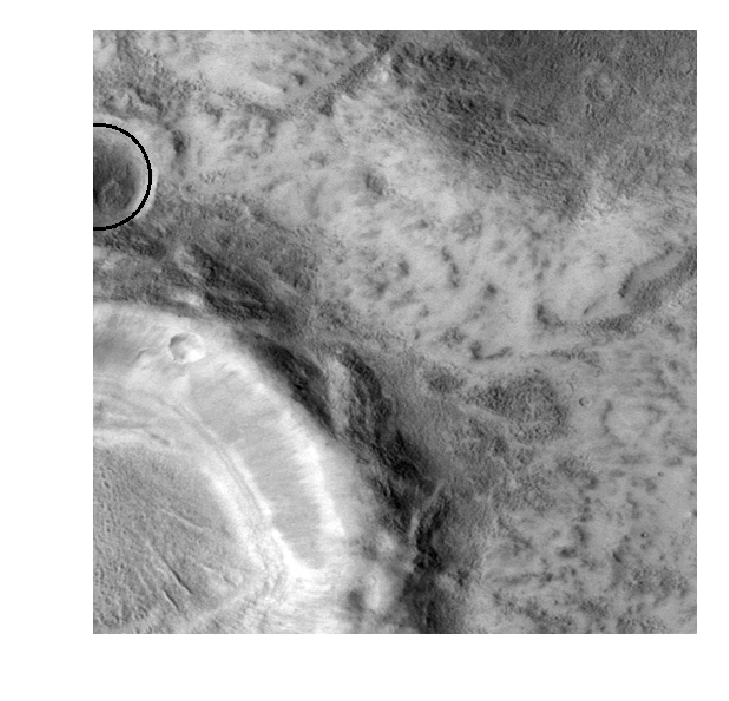

[[107.         282.          20.20358814]
 [445.         186.           6.27833297]]
(512, 512)


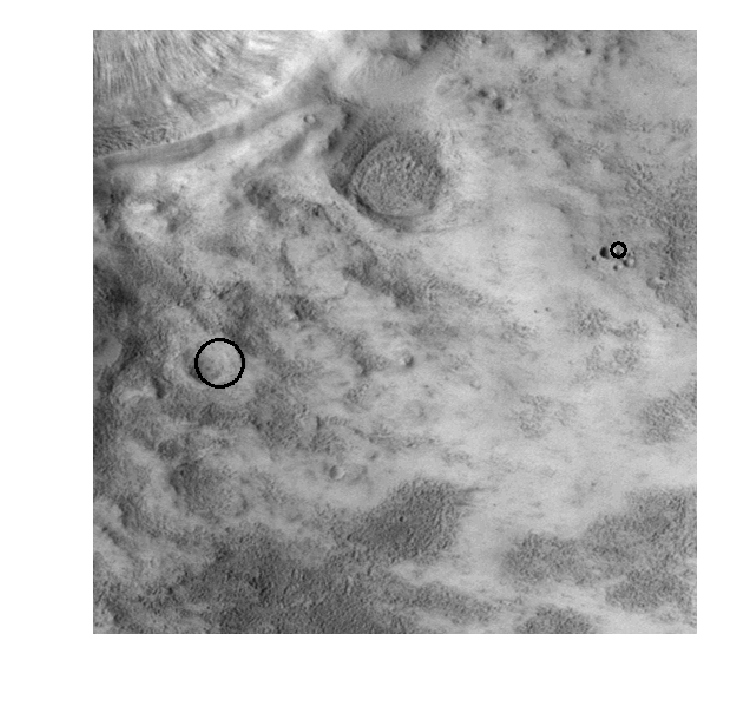

[[159.         167.           6.19202125]
 [160.         121.           5.42702951]
 [207.         461.           6.29889699]
 [234.         507.           5.21315947]]
(512, 512)


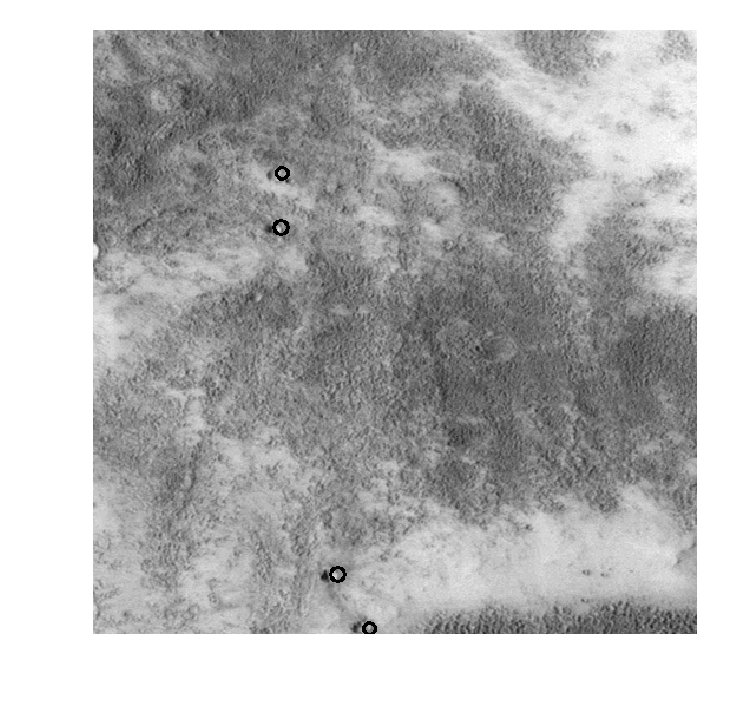

[ 92.         247.          17.10840943]
(512, 512)


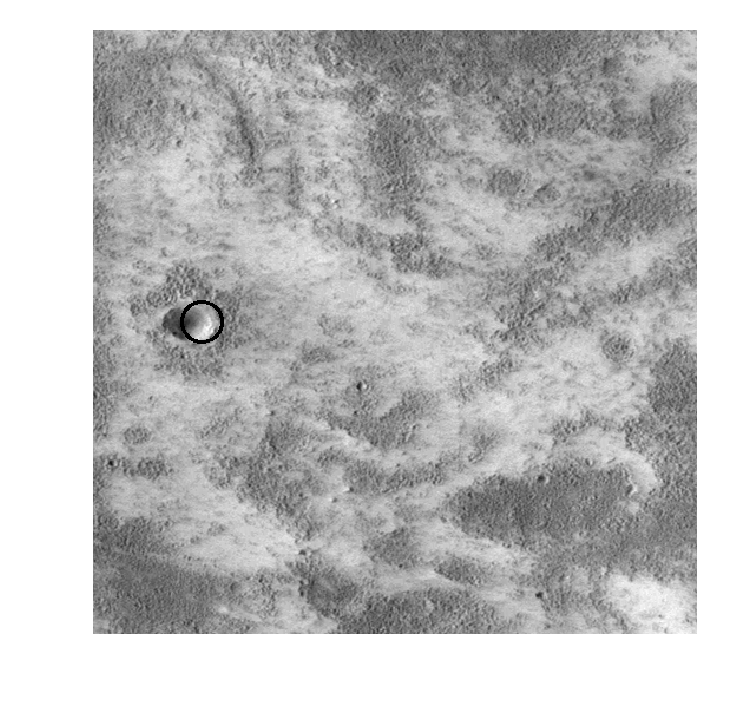

[181.         171.          28.36822489]
(512, 512)


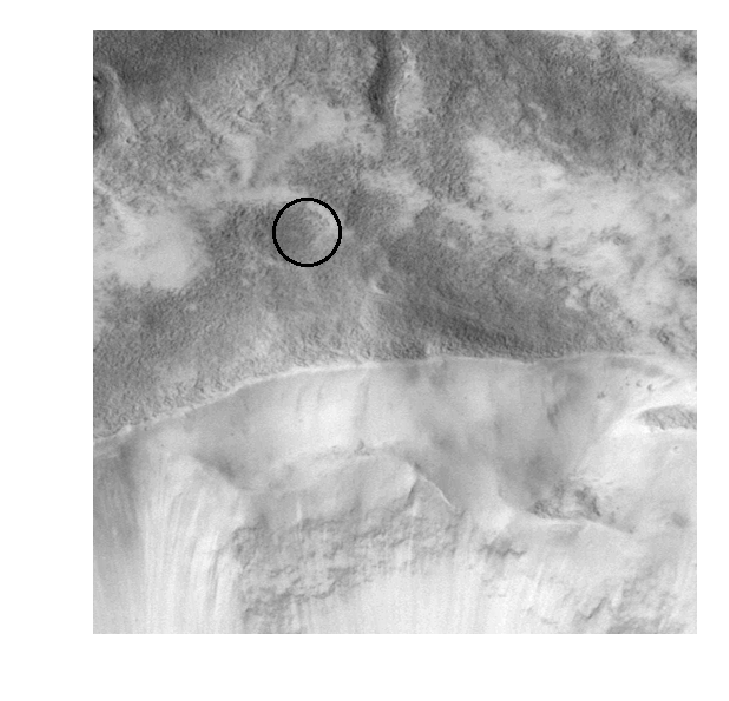

[[111.         232.          28.2236647 ]
 [467.         303.           8.29499002]
 [439.         234.           6.62734785]
 [426.         467.          10.92290302]
 [ 33.         438.           8.486856  ]]
(512, 512)


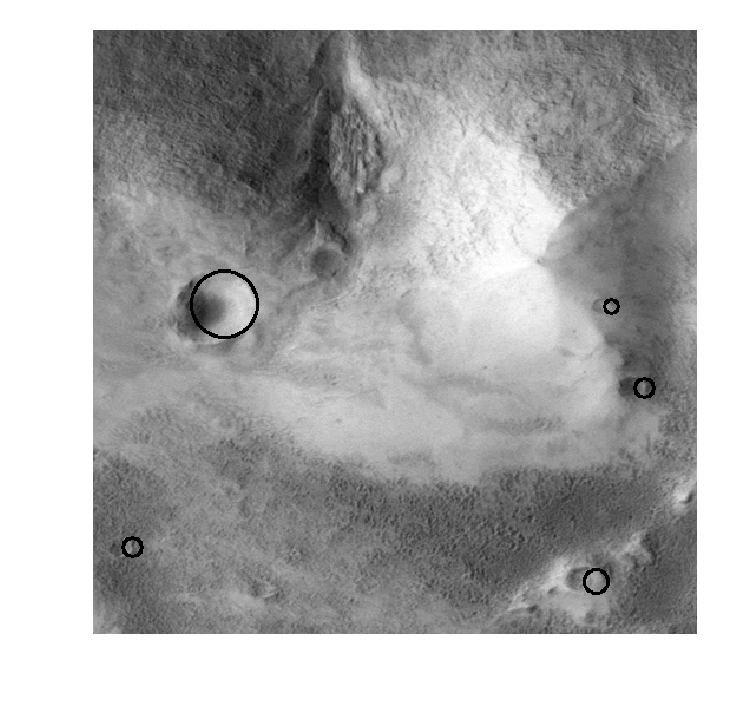

[[371.         112.          90.84242764]
 [ 61.          34.          61.70371843]]
(512, 512)


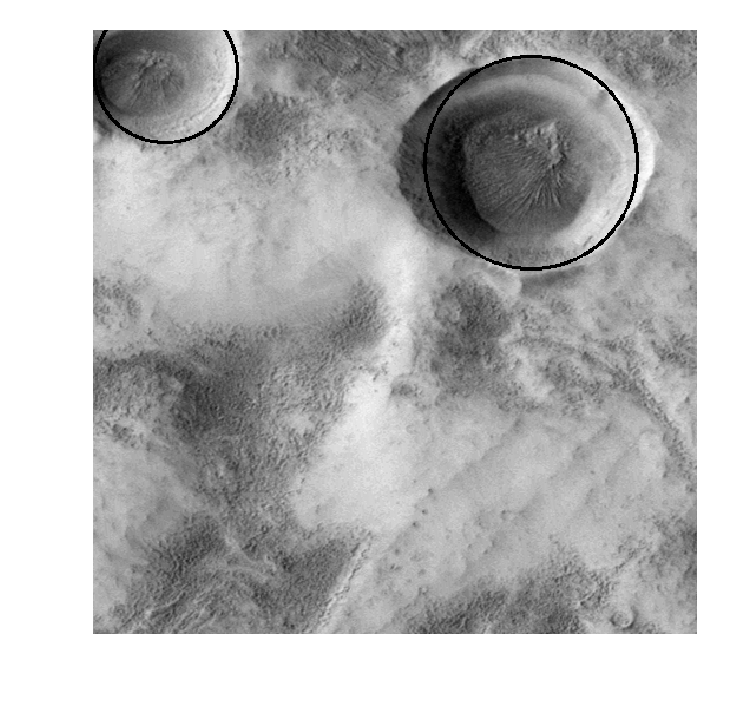

In [3]:
mpl.rcParams['figure.dpi'] = 200
mpl.rc('axes.spines',top=False,bottom=False,left=False,right=False)
mpl.rc('axes',facecolor=(1,1,1,0),edgecolor=(1,1,1,0))
mpl.rc(('xtick','ytick'),color=(1,1,1,0))

IMSCALE = 512
Nviz = 10 # Home many random images to visualize

DATA_PATH = '/home-nfs/ivas/ivas/data/CTX/ctx_dataset/'
large_images = os.listdir('/home-nfs/ivas/ivas/data/CTX/ctx_dataset/')

CTX_LIST="/share/data/vision-greg/ivas/data/CTX/ctx_dataset/cleaned_files.txt"
CTX_PATH='/share/data/vision-greg/ivas/data/CTX/CTX'

tmp = '/home-nfs/ivas/ivas/data/CTX/CTX' + ctx_image_list[0][1:] 
gtif = gdal.Open(tmp)
band = gtif.GetRasterBand(1)
raster_data = band.ReadAsArray()
raster_data


class CraterDataset(Dataset):
    """Crater dataset."""

    def __init__(self, img_dir=CTX_LIST, transform=None):
        """
        Args:
            img_dir: this is where all images and labels.txt live
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.data_dir = [x.strip() for x in open(img_dir).readlines()]
        self.transform = transform

    def __len__(self):
        return len(self.data_dir)

    def __getitem__(self, i):
        
        #img_name = os.path.join(CTX_PATH,self.data_dir[idx][1:])
    
        big_image = ctx_image_list[i].split("/")[1]

        LABEL_PATH = '/home-nfs/ivas/ivas/data/CTX/ctx_dataset/' + big_image + "/" +'labels.txt'
        IMAGE_PATH = '/home-nfs/ivas/ivas/data/CTX/ctx_dataset/' + big_image + "/" +'tiffs.txt'

        labels = np.loadtxt(LABEL_PATH)
        imlist = [x.strip() for x in open(IMAGE_PATH).readlines()]

        idx = imlist.index('./CTX'+ctx_image_list[i][1:])
        circles = labels[labels[:,0]==idx][:,1:]

        img_name = CTX_PATH + self.data_dir[i][1:]
    
        gtif = gdal.Open(img_name)
        band = gtif.GetRasterBand(1)
        image = band.ReadAsArray()
      
        sample = {'image': image, 'loc': circles.squeeze()}


        return sample

    
crater_dataset = CraterDataset()
print(len(crater_dataset))


random_craters = np.random.permutation(len(crater_dataset))


np.random.seed(0)
train_craters = np.random.permutation(len(crater_dataset))[0:1400]

for i in range(100):
    #print(idx)
    #print(tmp[idx])
    sample = crater_dataset[i]

    image = sample['image']
    craterloc = sample['loc']
    print(craterloc)

    if len(craterloc.shape) == 1:
        x = craterloc[0] 
        y = craterloc[1] 
        r = craterloc[2] 
        cv2.circle(image, (int(x), int(y)), int(r), (0, 0, 255),2)
    else:
        for i in range(craterloc.shape[0]):
            x = craterloc[i][0] 
            y = craterloc[i][1] 
            r = craterloc[i][2]
            cv2.circle(image, (int(x), int(y)), int(r), (0, 0, 255),2)

    print(image.shape)
    plt.imshow(image, cmap='gray')
    plt.show()

In [4]:
'''
creating crater vs not crater dataset
Fix at 128x128, 64x64 etc
'''

mpl.rcParams['figure.dpi'] = 50


def generate_X(name, pos):

    X_train = np.zeros([1, 64, 64])
    count = 0
    mult = 1
    if not pos:
        mult = 4
    for i in random_craters:
        radii = []
        max_ = 0
    
        sample = crater_dataset[i]
    
        image = sample['image']
        craterloc = sample['loc']
    
        if len(craterloc.shape) < 2:
            craterloc = np.expand_dims(craterloc,0)
    
        for jj in range(mult*craterloc.shape[0]):
            
            if pos:
                detections = craterloc[jj]
                xOffset = int(detections[1]) 
                yOffset = int(detections[0]) 
                radius = detections[2]
            else:
                xOffset = np.random.randint(IMSCALE - 100)
                yOffset = np.random.randint(IMSCALE - 100)
                #radius = detections[2]
        
            extent = 32
            positive = image[xOffset - extent : xOffset + extent, yOffset - extent : yOffset + extent]
            #print(positive.shape)
            if positive.shape[0] == 64 and positive.shape[1] == 64 and np.sum(positive) > 0:
                X_train = np.append(X_train, np.expand_dims(positive,0), 0)
                print(count)
                count = count + 1
            if pos:
                radii.append(radius)
     
                    
    np.save(name, X_train)

#generate_X("./data/X_train_pos.npy", pos=True)
#generate_X("./data/X_train_negative.npy", pos=False)

In [5]:
X_pos_train = np.load("./data/X_train_pos.npy")
X_neg_train = np.load("./data/X_train_negative.npy")

(9000, 64, 64)
(9000, 64, 64)
0.0


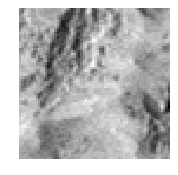

1.0


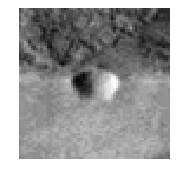

0.0


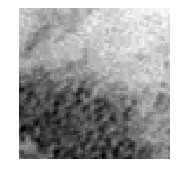

0.0


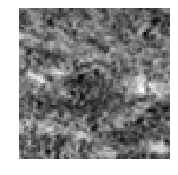

1.0


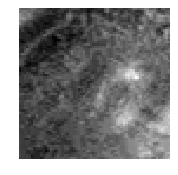

0.0


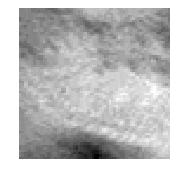

1.0


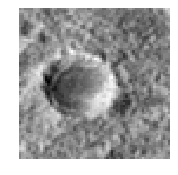

0.0


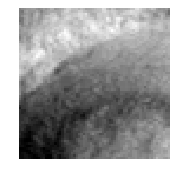

1.0


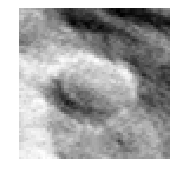

1.0


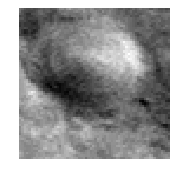

0.0


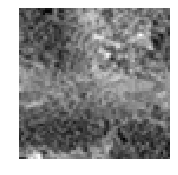

1.0


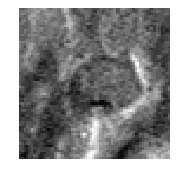

0.0


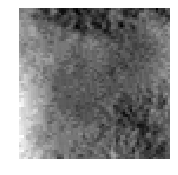

0.0


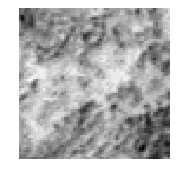

0.0


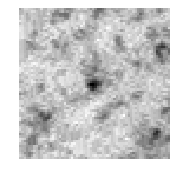

0.0


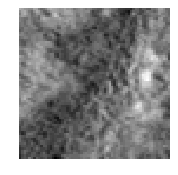

0.0


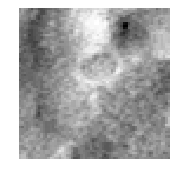

1.0


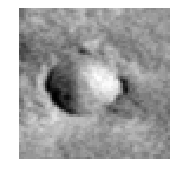

0.0


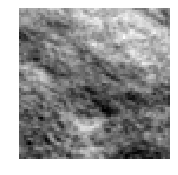

0.0


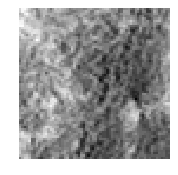

0.0


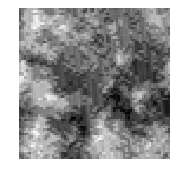

0.0


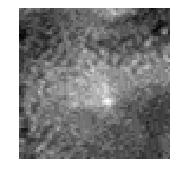

1.0


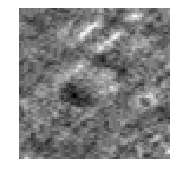

0.0


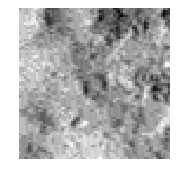

0.0


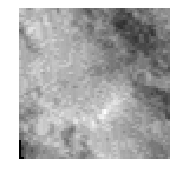

1.0


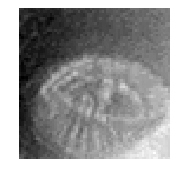

1.0


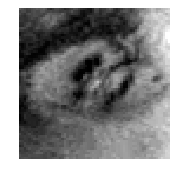

0.0


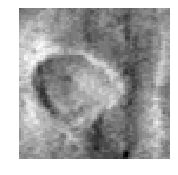

0.0


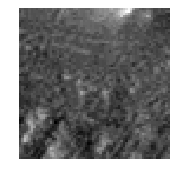

0.0


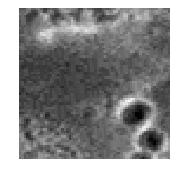

1.0


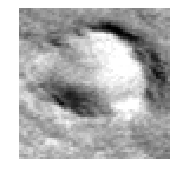

0.0


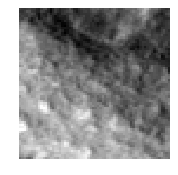

0.0


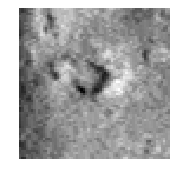

1.0


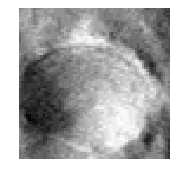

0.0


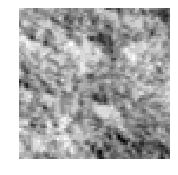

0.0


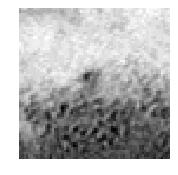

1.0


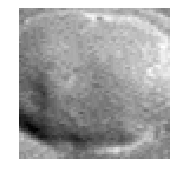

0.0


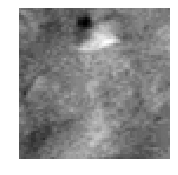

1.0


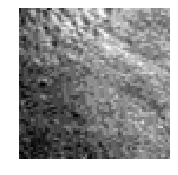

1.0


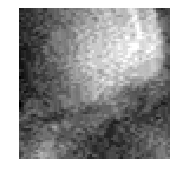

0.0


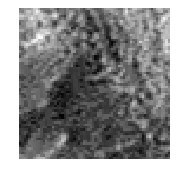

1.0


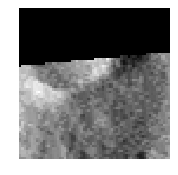

0.0


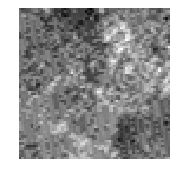

1.0


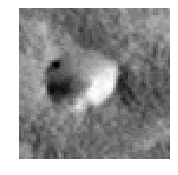

0.0


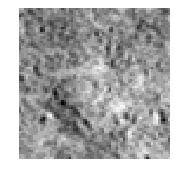

1.0


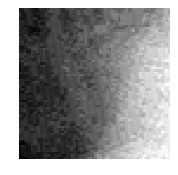

0.0


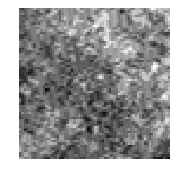

0.0


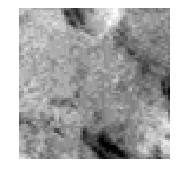

0.0


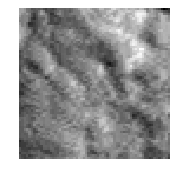

0.0


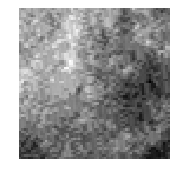

In [6]:
"""
Prepare dataset
"""
from sklearn.utils import shuffle

mpl.rcParams['figure.dpi'] = 50

if 1:
    X_pos = np.load("./data/X_train_pos.npy")
    X_neg = np.load("./data/X_train_negative.npy")

    X_pos = shuffle(X_pos)
    X_pos_train = X_pos[0:3000,:]
    X_pos_val = X_pos[3000:3050, :] # 85
    
    X_neg = shuffle(X_neg)
    X_neg_train = X_neg[0:6000,:]
    X_neg_val = X_neg[6000:6050,:] #85

    X_train = np.concatenate((X_pos_train, X_neg_train),0)
    print(X_train.shape)
    X_val = np.concatenate((X_pos_val, X_neg_val),0)

    y_label = np.hstack((np.ones(3000), np.zeros(6000)))
    np.save("./data/X_train.npy", X_train)
    np.save("X_val.npy", X_val)

X_train = np.load("./data/X_train.npy")
print(X_train.shape)

y_train = np.hstack((np.ones(3000), np.zeros(6000)))

X_train, y_train = shuffle(X_train, y_train, random_state = 0)

X_val = np.load("X_val.npy")
y_val = np.hstack((np.ones(50), np.zeros(50)))

for i in range(50):
    print(y_train[i])
    #print(np.sum(X_train[i,:]))
    plt.imshow(X_train[i,:], cmap='gray')
    plt.show()

#X, y = shuffle(X, y, random_state=0)

## Training the neural net

In [7]:
def to_pytorch(var):
    var = torch.from_numpy(var).cuda()
    return Variable(var).float()

class CraterNet(nn.Module):
    def __init__(self):
        super(CraterNet, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3)
        self.conv2 = nn.Conv2d(32, 32, kernel_size=3)
        self.conv3 = nn.Conv2d(32, 64, kernel_size=3)
        self.conv4 = nn.Conv2d(64, 64, kernel_size=3)
        self.conv5 = nn.Conv2d(64, 64, kernel_size=3)
        self.conv6 = nn.Conv2d(64, 64, kernel_size=3)
        self.conv7 = nn.Conv2d(64, 64, kernel_size=3)

        self.conv_drop = nn.Dropout2d(0.25)
        #self.fc1 = nn.Linear(256, 128)
        self.fc2 = nn.Linear(1024, 1)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.max_pool2d(x, 2)

        x = F.relu(self.conv3(x))
        x = F.max_pool2d(x, 2)

        x = F.relu(self.conv5(x))
        x = F.max_pool2d(x, 2)

        x = F.relu(self.conv7(x))

        x = x.view(-1, 1024)
        x = F.relu(self.fc2(x))
        #x = F.dropout(x)#, training=self.training)
        #x = F.sigmoid(self.fc2(x))
        return F.sigmoid(x)

model = CraterNet()
model.cuda()

optimizer = optim.Adam(model.parameters(), lr=1e-2)
#optimizer = optim.SGD(model.parameters(), lr=1e-3)
criterion = torch.nn.BCELoss()

def train(epoch, X_train, y_train):
    model.train()

    for i in range(epoch):
        #X_train, y_train = shuffle(X_train, y_train, random_state = 0)
        for it in range(100):
            idx = np.random.permutation(9000)[0:256]
            batch_x = np.expand_dims(X_train[idx,:],0) / 255.
            batch_x = np.swapaxes(batch_x, 0, 1)
            
            batch_y = y_train[idx]
            batch_y = np.expand_dims(batch_y, -1)
        
            X_data, target = to_pytorch(np.array(batch_x)), to_pytorch(np.array(batch_y))
            optimizer.zero_grad()
            prediction = model(X_data)
            output = criterion(prediction, target)
            output.backward()
            optimizer.step()
            if it % 25 == 0:
                print('Loss: ', output.data[0])

            if it % 50 == 0:
                print("True: ", y_train[idx[0]])
                model.eval()
                tmp = np.expand_dims(np.expand_dims(X_train[idx[0]], 0), 0)
                y_pred = model(to_pytorch(tmp))
                y_pred = y_pred.data.cpu().numpy().squeeze()
                print("Predicted: ", y_pred)
                model.train()

#train(10, X_train, y_train)
#train(20, X_train, y_train)

In [8]:
# import the necessary packages
import numpy as np
 
# Malisiewicz et al.
def non_max_suppression_fast(boxes, overlapThresh):
	# if there are no boxes, return an empty list
	if len(boxes) == 0:
		return []
 
	# if the bounding boxes integers, convert them to floats --
	# this is important since we'll be doing a bunch of divisions
	if boxes.dtype.kind == "i":
		boxes = boxes.astype("float")
 
	# initialize the list of picked indexes	
	pick = []
 
	# grab the coordinates of the bounding boxes
	x1 = boxes[:,0]
	y1 = boxes[:,1]
	x2 = boxes[:,2]
	y2 = boxes[:,3]
 
	# compute the area of the bounding boxes and sort the bounding
	# boxes by the bottom-right y-coordinate of the bounding box
	area = (x2 - x1 + 1) * (y2 - y1 + 1)
	idxs = np.argsort(y2)
 
	# keep looping while some indexes still remain in the indexes
	# list
	while len(idxs) > 0:
		# grab the last index in the indexes list and add the
		# index value to the list of picked indexes
		last = len(idxs) - 1
		i = idxs[last]
		pick.append(i)
 
		# find the largest (x, y) coordinates for the start of
		# the bounding box and the smallest (x, y) coordinates
		# for the end of the bounding box
		xx1 = np.maximum(x1[i], x1[idxs[:last]])
		yy1 = np.maximum(y1[i], y1[idxs[:last]])
		xx2 = np.minimum(x2[i], x2[idxs[:last]])
		yy2 = np.minimum(y2[i], y2[idxs[:last]])
 
		# compute the width and height of the bounding box
		w = np.maximum(0, xx2 - xx1 + 1)
		h = np.maximum(0, yy2 - yy1 + 1)
 
		# compute the ratio of overlap
		overlap = (w * h) / area[idxs[:last]]
 
		# delete all indexes from the index list that have
		idxs = np.delete(idxs, np.concatenate(([last],
			np.where(overlap > overlapThresh)[0])))
 
	# return only the bounding boxes that were picked using the
	# integer data type
	return boxes[pick].astype("int")

## Evaluation

In [14]:
"""
mpl.rcParams['figure.dpi'] = 200
model.eval()

def plot_predicted(image, craterloc, stride = 8):
    detections = []
    
    for i in range(craterloc.shape[0]):
        x = craterloc[i][0] * IMSCALE
        y = craterloc[i][1] * IMSCALE
        r = craterloc[i][2] * IMSCALE
        cv2.circle(image, (int(x), int(y)), int(r), (0, 0, 255),2)
    
    for i in range(0, IMSCALE, stride):
        for j in range(0, IMSCALE, stride):
            patch = image[i: (i+64), j:(j+64)]
            if patch.shape[0] == 64 and patch.shape[1] == 64:
                patch = np.expand_dims(np.expand_dims(patch, 0), 0)
                y_pred = model(to_pytorch(patch))
                y_pred = y_pred.data.cpu().numpy().squeeze()
                if y_pred > 0.5:#0.999:
                    ymin = i
                    xmin = j
                    ymax = i + 64
                    xmax = j + 64
                    detections.append([xmin, ymin, xmax, ymax])
                    #cv2.rectangle(image, (int(xmin), int(ymin)), (int(xmax), int(ymax)), (0, 0, 255),2)
                  
    refined = []
    for i in range(1, len(detections)):
        candidate = detections[i]
        if  sum([a_i - b_i for a_i, b_i in zip(detections[i], detections[i-1])]) < 100:
            refined.append(candidate)
    
    refined = non_max_suppression_fast(np.array(refined), 0.3)
    
    for i in range(len(refined)):
            candidate = refined[i]
            xmin = candidate[0]
            ymin = candidate[1]
            xmax = candidate[2]
            ymax = candidate[3] 
            cv2.rectangle(image, (int(xmin), int(ymin)), (int(xmax), int(ymax)), (0, 0, 255),2)
 
    plt.imshow(image, cmap='gray')
    #return detections
    

#indices = np.random.permutation(2000)[0:100]
for idx in range(20):
    #idx = 5
    print(idx)
    sample = crater_dataset[idx]

    image = sample['image']
    craterloc = sample['loc']
    #detections = plot_predicted(image, craterloc)
    #print(detections)
    #print(len(craterloc.shape))
    if len(craterloc.shape) > 1:
        plot_predicted(image, craterloc, 8)
        for i in range(craterloc.shape[0]):
            x = craterloc[i][0] 
            y = craterloc[i][1] 
            r = craterloc[i][2]
            cv2.circle(image, (int(x), int(y)), int(r), (0, 0, 255),2)
        plt.imshow(image, cmap='gray')
        plt.show()
        #plt.show()


            

"""
print("\n")